# Session (466029_f3_stage2_day11)

# Processing of Raw Calcium Cortical Data into dFF tiff Stacks

In [1]:
"""install the packages to run this code"""
#%pip install matplotlib tifffile scipy tqdm pybaselines opencv-python imagecodecs pickle #plotly #need to do this through conda install

'install the packages to run this code'

In [2]:
session = "466029_f3_stage2_day11" #cageID_mouseID_stage_day

## Step 1: importing the proper libraries

note: all packaged are compatible with Python 3.12 as of 2024, Feb 22

In [3]:
import numpy as np
import matplotlib.pyplot as plt
import tifffile
import cv2
from scipy import interpolate
from scipy.interpolate import interp1d
from scipy.ndimage import gaussian_filter
from scipy.signal import cheby1, filtfilt, find_peaks, peak_widths
import scipy
from tqdm import tqdm
%matplotlib inline
import plotly.express as px
import imagecodecs
from matplotlib.animation import FuncAnimation
import pickle
from pybaselines import Baseline
import pandas as pd
from ipywidgets import interact, FloatSlider
import matplotlib.gridspec as gridspec

from preprocessing_functions import (load_frames, 
                                        interactive_plot, 
                                        plot_frame, 
                                        temporal_mean, 
                                        remove_dark_frames, 
                                        extract_artifacts, 
                                        interpolate, 
                                        dff, 
                                        smoothing, 
                                        save_tiff,
                                        load_txt,
                                        extract_txt_flashes,
                                        load_masks, 
                                        avg_trials,
                                        extract_v1,
                                        animate_figure, 
extract_success,
sort_success,
extract_nogo)

## Step 2: importing and exporting from the script

### 2A: Manual importing data and paths

Please insert the file path for the tif stack as a 3d array

In [4]:
missing_artifacts = "TRUE"

In [5]:
cohort = "3_third_cohort"

### 2B: Manual Exporting data path

In [6]:
parts = session.split("_") # Split the string by underscores

cageID_mouseID = f"{parts[0]}_{parts[1]}" #cageID_mouseID
cageID, mouseID = parts[0], parts[1] #newv2
day = parts[3]  # what day of the stage they are in

print(f"cageID_mouseID = \"{cageID_mouseID}\"")
print(f"day = \"{day}\"")

cageID_mouseID = "466029_f3"
day = "day11"


### 2C: autonomous loadings and exporting lines !do not need to manipulate!

#### 2C.1: loading frames in

In [7]:
common_cortical_path = "X:/RaymondLab/1_Kai/1_cortical_data/"

In [8]:
video = f"{common_cortical_path}/{cohort}/stage2/{session}.tif"

In [9]:
frame_number = 6000 #please insert frame number to view
frames = load_frames(video); #loading in tif stack, this will take a little while

loading video, please wait...


dimensions are (34772, 128, 128) as a uint16


#### 2C.2: Tiff stack (spatial view videos) export

make sure folders exists: files are organized by common_tiff_path -> stage -> day -> full,single,double -> File_name(cage_mouseid_stage_day_condition)

In [10]:
common_tiff_path = "X:/RaymondLab/1_Kai/3_processed_data/1_tiff_stacks/stage2/"

In [11]:
tiff_path_full = f"{common_tiff_path}{day}/full_frame/{cageID_mouseID}_stage2_{day}_full_frame.tiff"
tiff_path_single = f"{common_tiff_path}{day}/single/{cageID_mouseID}_stage2_{day}_single.tiff"
tiff_path_double = f"{common_tiff_path}{day}/double/{cageID_mouseID}_stage2_{day}_double.tiff"

#### 2C.3: Pickle export timeseries array

make sure folders exist: files are organized by common_pickle_path -> stage -> day -> single,double -> ROI -> File_name(cage_mouseid_stage_day_condition)

In [12]:
common_pickle_path = "X:/RaymondLab/1_Kai/3_processed_data/2_pickle/stage2/"

In [13]:
pickle_single_v1 = f"{common_pickle_path}{day}/single/v1/{cageID_mouseID}_stage2_{day}_single_v1.pickle"
pickle_double_v1 = f"{common_pickle_path}{day}/double/v1/{cageID_mouseID}_stage2_{day}_double_v1.pickle"

pickle_single_success_ff = f"{common_pickle_path}single/success/full_frame/{cageID_mouseID}_stage2_{day}_single_success_ff.pickle"
pickle_double_success_ff = f"{common_pickle_path}double/success/full_frame/{cageID_mouseID}_stage2_{day}_double_success_ff.pickle"
pickle_nogo_success_ff = f"{common_pickle_path}nogo/success/full_frame/{cageID_mouseID}_stage2_{day}_nogo_success_ff.pickle"

pickle_single_fail_ff = f"{common_pickle_path}single/fail/full_frame/{cageID_mouseID}_stage2_{day}_single_fail_ff.pickle"
pickle_double_fail_ff = f"{common_pickle_path}double/fail/full_frame/{cageID_mouseID}_stage2_{day}_double_fail_ff.pickle"
pickle_nogo_fail_ff = f"{common_pickle_path}nogo/fail/full_frame/{cageID_mouseID}_stage2_{day}_nogo_fail_ff.pickle"

## Step 3: Plot of Raw Frames and Timecourse

### 3A: Plotting raw frame example, to make sure the tif stack loaded in properly.


Make sure the frames are a 3d array, two figures will be generated, a greyscaled and colormapped. They are technically identical

frame number 6000 plotted


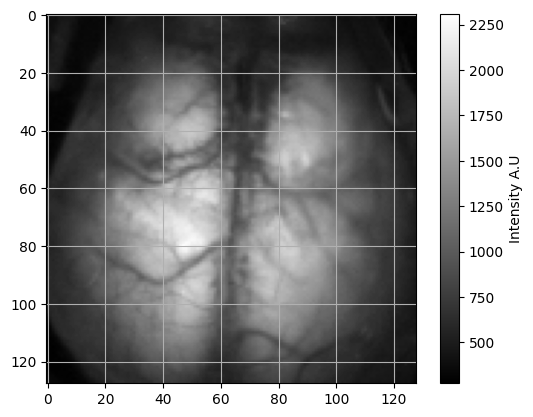

frame number 6000 plotted


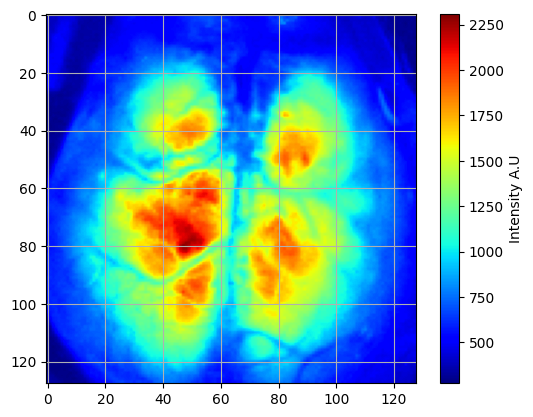

In [14]:
plot_frame(frames, frame_number, cmap = 'grey', color_label = "Intensity A.U")
plot_frame(frames, frame_number, cmap = 'jet', color_label = "Intensity A.U")

### 3B: Plot of the raw signal mean for each frame over the length of the experiment

Mean time course of the raw signal

In [15]:
mean_timecourse = temporal_mean(frames);

default 20% threshold is 265.100390625 Determine if adjustments need to be made


## Step 4: Mean Timecourse without Darkframes at Start and End

#### 4A: plot of timecourse

#### 4B: number of single and double flashes as well as total number.

In [16]:
darkf_removed = remove_dark_frames(frames, mean_timecourse, 0.35)
darkf_removed_timecourse, darkf_removed_frames = darkf_removed[0], darkf_removed[1] #first one is the timecourse with no 3d, second is the 3d array

threshold determined to be: 298.237939453125


#### 4C: pybaselines (only run if missing flashes)

Number of double_flash: 112
Number of double_flash pairs: 56
Number of single_flash: 40
Number of total flashes: 152


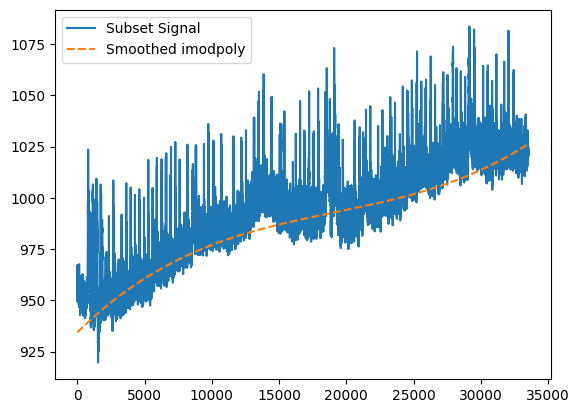

In [17]:
if missing_artifacts == "TRUE":
    x = np.linspace(0, len(darkf_removed_timecourse), len(darkf_removed_timecourse))
    baseline_fitter = Baseline(x_data=x)

    smoothed_imodpoly = baseline_fitter.imodpoly(darkf_removed_timecourse, poly_order=3, num_std=0.7)[0]
    flattened = darkf_removed_timecourse-smoothed_imodpoly

    artifacts = extract_artifacts(flattened)
    artifact_indices, single_indices, double_indices = artifacts[0], artifacts[1], artifacts[2]

    #plotting moving mean and signal
    fig = px.line(y = [flattened])
    fig.update_layout(
    title= "mean timecourse with moving average overlay",
    xaxis=dict(title="frame number (30 fps)"),
    yaxis=dict(title="intensity value (A.U)"),
    xaxis_rangeslider_visible=True,
    showlegend=True)

    fig.for_each_trace(lambda t: t.update(name="Signal") if "0" in t.name else t.update(name="10s Moving Average"))

    fig.show()

    plt.figure()
    plt.plot(darkf_removed_timecourse, label='Subset Signal')
    plt.plot(smoothed_imodpoly, '--', label='Smoothed imodpoly')
    plt.legend()
    plt.show()

!! If the total does not match the single and double combined, check dataset!!

In [18]:
if missing_artifacts == "FALSE": #newv2
    artifacts = extract_artifacts(darkf_removed_timecourse)
    artifact_indices, single_indices, double_indices = artifacts[0], artifacts[1], artifacts[2]

## Step 5: Artifact Removal and DFF

### 5A: Plot of mean timecourse with artifacts removed


plot is generated with interpolated frames where the artifacts were, approximately 5 frames

In [19]:
no_artifact_timecourse = interpolate(darkf_removed_frames, artifact_indices, 5)

interpolating artifact frames...


  0%|                                                                                          | 0/152 [00:00<?, ?it/s]

  1%|▌                                                                                 | 1/152 [00:01<03:19,  1.32s/it]

  1%|█                                                                                 | 2/152 [00:02<03:14,  1.29s/it]

  2%|█▌                                                                                | 3/152 [00:03<03:14,  1.31s/it]

  3%|██▏                                                                               | 4/152 [00:05<03:13,  1.31s/it]

  3%|██▋                                                                               | 5/152 [00:06<03:12,  1.31s/it]

  4%|███▏                                                                              | 6/152 [00:07<03:10,  1.31s/it]

  5%|███▊                                                                              | 7/152 [00:09<03:10,  1.32s/it]

  5%|████▎                                                                             | 8/152 [00:10<03:09,  1.32s/it]

  6%|████▊                                                                             | 9/152 [00:11<03:11,  1.34s/it]

  7%|█████▎                                                                           | 10/152 [00:13<03:10,  1.34s/it]

  7%|█████▊                                                                           | 11/152 [00:14<03:08,  1.34s/it]

  8%|██████▍                                                                          | 12/152 [00:15<03:03,  1.31s/it]

  9%|██████▉                                                                          | 13/152 [00:17<03:00,  1.30s/it]

  9%|███████▍                                                                         | 14/152 [00:18<02:57,  1.29s/it]

 10%|███████▉                                                                         | 15/152 [00:19<02:56,  1.29s/it]

 11%|████████▌                                                                        | 16/152 [00:20<02:55,  1.29s/it]

 11%|█████████                                                                        | 17/152 [00:22<02:59,  1.33s/it]

 12%|█████████▌                                                                       | 18/152 [00:23<03:03,  1.37s/it]

 12%|██████████▏                                                                      | 19/152 [00:25<03:04,  1.39s/it]

 13%|██████████▋                                                                      | 20/152 [00:26<02:59,  1.36s/it]

 14%|███████████▏                                                                     | 21/152 [00:27<02:57,  1.36s/it]

 14%|███████████▋                                                                     | 22/152 [00:29<02:57,  1.36s/it]

 15%|████████████▎                                                                    | 23/152 [00:30<02:54,  1.35s/it]

 16%|████████████▊                                                                    | 24/152 [00:32<02:55,  1.37s/it]

 16%|█████████████▎                                                                   | 25/152 [00:33<02:54,  1.37s/it]

 17%|█████████████▊                                                                   | 26/152 [00:34<02:52,  1.37s/it]

 18%|██████████████▍                                                                  | 27/152 [00:36<02:49,  1.35s/it]

 18%|██████████████▉                                                                  | 28/152 [00:37<02:50,  1.38s/it]

 19%|███████████████▍                                                                 | 29/152 [00:38<02:46,  1.35s/it]

 20%|███████████████▉                                                                 | 30/152 [00:40<02:42,  1.33s/it]

 20%|████████████████▌                                                                | 31/152 [00:41<02:43,  1.35s/it]

 21%|█████████████████                                                                | 32/152 [00:42<02:40,  1.34s/it]

 22%|█████████████████▌                                                               | 33/152 [00:44<02:36,  1.32s/it]

 22%|██████████████████                                                               | 34/152 [00:45<02:36,  1.33s/it]

 23%|██████████████████▋                                                              | 35/152 [00:46<02:33,  1.31s/it]

 24%|███████████████████▏                                                             | 36/152 [00:48<02:34,  1.33s/it]

 24%|███████████████████▋                                                             | 37/152 [00:49<02:33,  1.34s/it]

 25%|████████████████████▎                                                            | 38/152 [00:50<02:32,  1.34s/it]

 26%|████████████████████▊                                                            | 39/152 [00:52<02:30,  1.34s/it]

 26%|█████████████████████▎                                                           | 40/152 [00:53<02:30,  1.34s/it]

 27%|█████████████████████▊                                                           | 41/152 [00:54<02:29,  1.35s/it]

 28%|██████████████████████▍                                                          | 42/152 [00:56<02:25,  1.32s/it]

 28%|██████████████████████▉                                                          | 43/152 [00:57<02:23,  1.31s/it]

 29%|███████████████████████▍                                                         | 44/152 [00:58<02:24,  1.33s/it]

 30%|███████████████████████▉                                                         | 45/152 [01:00<02:22,  1.33s/it]

 30%|████████████████████████▌                                                        | 46/152 [01:01<02:21,  1.34s/it]

 31%|█████████████████████████                                                        | 47/152 [01:02<02:16,  1.30s/it]

 32%|█████████████████████████▌                                                       | 48/152 [01:03<02:15,  1.30s/it]

 32%|██████████████████████████                                                       | 49/152 [01:05<02:15,  1.32s/it]

 33%|██████████████████████████▋                                                      | 50/152 [01:06<02:18,  1.36s/it]

 34%|███████████████████████████▏                                                     | 51/152 [01:08<02:17,  1.36s/it]

 34%|███████████████████████████▋                                                     | 52/152 [01:09<02:15,  1.35s/it]

 35%|████████████████████████████▏                                                    | 53/152 [01:10<02:13,  1.35s/it]

 36%|████████████████████████████▊                                                    | 54/152 [01:12<02:11,  1.34s/it]

 36%|█████████████████████████████▎                                                   | 55/152 [01:13<02:07,  1.31s/it]

 37%|█████████████████████████████▊                                                   | 56/152 [01:14<02:07,  1.33s/it]

 38%|██████████████████████████████▍                                                  | 57/152 [01:15<02:04,  1.32s/it]

 38%|██████████████████████████████▉                                                  | 58/152 [01:17<02:03,  1.31s/it]

 39%|███████████████████████████████▍                                                 | 59/152 [01:18<02:02,  1.32s/it]

 39%|███████████████████████████████▉                                                 | 60/152 [01:19<02:02,  1.33s/it]

 40%|████████████████████████████████▌                                                | 61/152 [01:21<02:00,  1.32s/it]

 41%|█████████████████████████████████                                                | 62/152 [01:22<01:59,  1.33s/it]

 41%|█████████████████████████████████▌                                               | 63/152 [01:23<01:58,  1.33s/it]

 42%|██████████████████████████████████                                               | 64/152 [01:25<01:56,  1.32s/it]

 43%|██████████████████████████████████▋                                              | 65/152 [01:26<01:56,  1.34s/it]

 43%|███████████████████████████████████▏                                             | 66/152 [01:28<01:57,  1.36s/it]

 44%|███████████████████████████████████▋                                             | 67/152 [01:29<01:55,  1.36s/it]

 45%|████████████████████████████████████▏                                            | 68/152 [01:30<01:54,  1.36s/it]

 45%|████████████████████████████████████▊                                            | 69/152 [01:32<01:53,  1.37s/it]

 46%|█████████████████████████████████████▎                                           | 70/152 [01:33<01:51,  1.36s/it]

 47%|█████████████████████████████████████▊                                           | 71/152 [01:34<01:47,  1.33s/it]

 47%|██████████████████████████████████████▎                                          | 72/152 [01:36<01:44,  1.31s/it]

 48%|██████████████████████████████████████▉                                          | 73/152 [01:37<01:44,  1.32s/it]

 49%|███████████████████████████████████████▍                                         | 74/152 [01:38<01:42,  1.32s/it]

 49%|███████████████████████████████████████▉                                         | 75/152 [01:40<01:43,  1.35s/it]

 50%|████████████████████████████████████████▌                                        | 76/152 [01:41<01:42,  1.35s/it]

 51%|█████████████████████████████████████████                                        | 77/152 [01:42<01:40,  1.35s/it]

 51%|█████████████████████████████████████████▌                                       | 78/152 [01:44<01:42,  1.38s/it]

 52%|██████████████████████████████████████████                                       | 79/152 [01:45<01:38,  1.35s/it]

 53%|██████████████████████████████████████████▋                                      | 80/152 [01:46<01:34,  1.31s/it]

 53%|███████████████████████████████████████████▏                                     | 81/152 [01:48<01:33,  1.32s/it]

 54%|███████████████████████████████████████████▋                                     | 82/152 [01:49<01:37,  1.39s/it]

 55%|████████████████████████████████████████████▏                                    | 83/152 [01:51<01:36,  1.40s/it]

 55%|████████████████████████████████████████████▊                                    | 84/152 [01:52<01:34,  1.39s/it]

 56%|█████████████████████████████████████████████▎                                   | 85/152 [01:53<01:32,  1.38s/it]

 57%|█████████████████████████████████████████████▊                                   | 86/152 [01:55<01:30,  1.37s/it]

 57%|██████████████████████████████████████████████▎                                  | 87/152 [01:56<01:30,  1.39s/it]

 58%|██████████████████████████████████████████████▉                                  | 88/152 [01:58<01:29,  1.39s/it]

 59%|███████████████████████████████████████████████▍                                 | 89/152 [01:59<01:26,  1.37s/it]

 59%|███████████████████████████████████████████████▉                                 | 90/152 [02:00<01:24,  1.37s/it]

 60%|████████████████████████████████████████████████▍                                | 91/152 [02:02<01:24,  1.38s/it]

 61%|█████████████████████████████████████████████████                                | 92/152 [02:03<01:21,  1.36s/it]

 61%|█████████████████████████████████████████████████▌                               | 93/152 [02:04<01:20,  1.37s/it]

 62%|██████████████████████████████████████████████████                               | 94/152 [02:06<01:20,  1.38s/it]

 62%|██████████████████████████████████████████████████▋                              | 95/152 [02:07<01:17,  1.37s/it]

 63%|███████████████████████████████████████████████████▏                             | 96/152 [02:08<01:16,  1.37s/it]

 64%|███████████████████████████████████████████████████▋                             | 97/152 [02:10<01:15,  1.37s/it]

 64%|████████████████████████████████████████████████████▏                            | 98/152 [02:11<01:14,  1.39s/it]

 65%|████████████████████████████████████████████████████▊                            | 99/152 [02:13<01:11,  1.36s/it]

 66%|████████████████████████████████████████████████████▋                           | 100/152 [02:14<01:09,  1.33s/it]

 66%|█████████████████████████████████████████████████████▏                          | 101/152 [02:15<01:09,  1.36s/it]

 67%|█████████████████████████████████████████████████████▋                          | 102/152 [02:17<01:07,  1.35s/it]

 68%|██████████████████████████████████████████████████████▏                         | 103/152 [02:18<01:06,  1.35s/it]

 68%|██████████████████████████████████████████████████████▋                         | 104/152 [02:19<01:04,  1.35s/it]

 69%|███████████████████████████████████████████████████████▎                        | 105/152 [02:21<01:02,  1.32s/it]

 70%|███████████████████████████████████████████████████████▊                        | 106/152 [02:22<01:01,  1.34s/it]

 70%|████████████████████████████████████████████████████████▎                       | 107/152 [02:23<01:00,  1.35s/it]

 71%|████████████████████████████████████████████████████████▊                       | 108/152 [02:24<00:57,  1.31s/it]

 72%|█████████████████████████████████████████████████████████▎                      | 109/152 [02:26<00:56,  1.31s/it]

 72%|█████████████████████████████████████████████████████████▉                      | 110/152 [02:27<00:54,  1.30s/it]

 73%|██████████████████████████████████████████████████████████▍                     | 111/152 [02:28<00:53,  1.32s/it]

 74%|██████████████████████████████████████████████████████████▉                     | 112/152 [02:30<00:52,  1.32s/it]

 74%|███████████████████████████████████████████████████████████▍                    | 113/152 [02:31<00:50,  1.29s/it]

 75%|████████████████████████████████████████████████████████████                    | 114/152 [02:32<00:49,  1.31s/it]

 76%|████████████████████████████████████████████████████████████▌                   | 115/152 [02:34<00:47,  1.29s/it]

 76%|█████████████████████████████████████████████████████████████                   | 116/152 [02:35<00:45,  1.28s/it]

 77%|█████████████████████████████████████████████████████████████▌                  | 117/152 [02:36<00:45,  1.30s/it]

 78%|██████████████████████████████████████████████████████████████                  | 118/152 [02:38<00:45,  1.32s/it]

 78%|██████████████████████████████████████████████████████████████▋                 | 119/152 [02:39<00:43,  1.33s/it]

 79%|███████████████████████████████████████████████████████████████▏                | 120/152 [02:40<00:42,  1.33s/it]

 80%|███████████████████████████████████████████████████████████████▋                | 121/152 [02:42<00:41,  1.33s/it]

 80%|████████████████████████████████████████████████████████████████▏               | 122/152 [02:43<00:39,  1.33s/it]

 81%|████████████████████████████████████████████████████████████████▋               | 123/152 [02:44<00:38,  1.33s/it]

 82%|█████████████████████████████████████████████████████████████████▎              | 124/152 [02:46<00:37,  1.33s/it]

 82%|█████████████████████████████████████████████████████████████████▊              | 125/152 [02:47<00:35,  1.32s/it]

 83%|██████████████████████████████████████████████████████████████████▎             | 126/152 [02:48<00:34,  1.33s/it]

 84%|██████████████████████████████████████████████████████████████████▊             | 127/152 [02:49<00:32,  1.30s/it]

 84%|███████████████████████████████████████████████████████████████████▎            | 128/152 [02:51<00:31,  1.32s/it]

 85%|███████████████████████████████████████████████████████████████████▉            | 129/152 [02:52<00:30,  1.33s/it]

 86%|████████████████████████████████████████████████████████████████████▍           | 130/152 [02:53<00:29,  1.33s/it]

 86%|████████████████████████████████████████████████████████████████████▉           | 131/152 [02:55<00:28,  1.34s/it]

 87%|█████████████████████████████████████████████████████████████████████▍          | 132/152 [02:56<00:27,  1.38s/it]

 88%|██████████████████████████████████████████████████████████████████████          | 133/152 [02:58<00:26,  1.38s/it]

 88%|██████████████████████████████████████████████████████████████████████▌         | 134/152 [02:59<00:24,  1.38s/it]

 89%|███████████████████████████████████████████████████████████████████████         | 135/152 [03:00<00:23,  1.38s/it]

 89%|███████████████████████████████████████████████████████████████████████▌        | 136/152 [03:02<00:21,  1.37s/it]

 90%|████████████████████████████████████████████████████████████████████████        | 137/152 [03:03<00:20,  1.35s/it]

 91%|████████████████████████████████████████████████████████████████████████▋       | 138/152 [03:04<00:18,  1.35s/it]

 91%|█████████████████████████████████████████████████████████████████████████▏      | 139/152 [03:06<00:17,  1.32s/it]

 92%|█████████████████████████████████████████████████████████████████████████▋      | 140/152 [03:07<00:15,  1.31s/it]

 93%|██████████████████████████████████████████████████████████████████████████▏     | 141/152 [03:08<00:14,  1.33s/it]

 93%|██████████████████████████████████████████████████████████████████████████▋     | 142/152 [03:10<00:13,  1.35s/it]

 94%|███████████████████████████████████████████████████████████████████████████▎    | 143/152 [03:11<00:12,  1.35s/it]

 95%|███████████████████████████████████████████████████████████████████████████▊    | 144/152 [03:13<00:11,  1.38s/it]

 95%|████████████████████████████████████████████████████████████████████████████▎   | 145/152 [03:14<00:09,  1.34s/it]

 96%|████████████████████████████████████████████████████████████████████████████▊   | 146/152 [03:15<00:08,  1.35s/it]

 97%|█████████████████████████████████████████████████████████████████████████████▎  | 147/152 [03:17<00:06,  1.36s/it]

 97%|█████████████████████████████████████████████████████████████████████████████▉  | 148/152 [03:18<00:05,  1.38s/it]

 98%|██████████████████████████████████████████████████████████████████████████████▍ | 149/152 [03:19<00:04,  1.37s/it]

 99%|██████████████████████████████████████████████████████████████████████████████▉ | 150/152 [03:21<00:02,  1.36s/it]

 99%|███████████████████████████████████████████████████████████████████████████████▍| 151/152 [03:22<00:01,  1.35s/it]

100%|████████████████████████████████████████████████████████████████████████████████| 152/152 [03:23<00:00,  1.38s/it]

100%|████████████████████████████████████████████████████████████████████████████████| 152/152 [03:23<00:00,  1.34s/it]

### 5B: Calculating dff


Dff calculated from the 3d array without artifacts, darkframes removed, and interpolated the space where the artifacts were. Then plotting of the signal with the 10s moving mean before dff is applied. dff is applied using this moving mean onto the signal

In [20]:
dff_array = dff(no_artifact_timecourse, 10, 30);
dff_signal, moving_average = dff_array[0], dff_array[1]

  0%|                                                                                          | 0/128 [00:00<?, ?it/s]

 19%|███████████████                                                                 | 24/128 [00:00<00:00, 237.53it/s]

 40%|███████████████████████████████▉                                                | 51/128 [00:00<00:00, 252.77it/s]

 62%|██████████████████████████████████████████████████                              | 80/128 [00:00<00:00, 265.86it/s]

 84%|██████████████████████████████████████████████████████████████████▋            | 108/128 [00:00<00:00, 271.27it/s]

100%|███████████████████████████████████████████████████████████████████████████████| 128/128 [00:00<00:00, 260.29it/s]

  0%|                                                                                        | 0/33538 [00:00<?, ?it/s]

  0%|                                                                              | 23/33538 [00:00<02:30, 223.38it/s]

  0%|                                                                              | 46/33538 [00:00<02:35, 214.96it/s]

  0%|▏                                                                             | 72/33538 [00:00<02:25, 230.75it/s]

  0%|▏                                                                            | 100/33538 [00:00<02:14, 248.47it/s]

  0%|▎                                                                            | 127/33538 [00:00<02:11, 254.28it/s]

  0%|▎                                                                            | 153/33538 [00:00<02:17, 242.01it/s]

  1%|▍                                                                            | 180/33538 [00:00<02:13, 249.94it/s]

  1%|▍                                                                            | 207/33538 [00:00<02:11, 253.78it/s]

  1%|▌                                                                            | 233/33538 [00:00<02:17, 241.79it/s]

  1%|▌                                                                            | 258/33538 [00:01<02:23, 232.72it/s]

  1%|▋                                                                            | 286/33538 [00:01<02:15, 245.44it/s]

  1%|▋                                                                            | 311/33538 [00:01<02:18, 239.21it/s]

  1%|▊                                                                            | 339/33538 [00:01<02:12, 250.14it/s]

  1%|▊                                                                            | 367/33538 [00:01<02:08, 257.30it/s]

  1%|▉                                                                            | 395/33538 [00:01<02:05, 263.54it/s]

  1%|▉                                                                            | 422/33538 [00:01<02:06, 260.87it/s]

  1%|█                                                                            | 449/33538 [00:01<02:08, 257.18it/s]

  1%|█                                                                            | 475/33538 [00:01<02:14, 245.26it/s]

  1%|█▏                                                                           | 503/33538 [00:02<02:10, 252.94it/s]

  2%|█▏                                                                           | 532/33538 [00:02<02:06, 261.67it/s]

  2%|█▎                                                                           | 560/33538 [00:02<02:03, 266.21it/s]

  2%|█▎                                                                           | 587/33538 [00:02<02:14, 245.22it/s]

  2%|█▍                                                                           | 615/33538 [00:02<02:10, 252.75it/s]

  2%|█▍                                                                           | 642/33538 [00:02<02:08, 256.19it/s]

  2%|█▌                                                                           | 669/33538 [00:02<02:06, 259.42it/s]

  2%|█▌                                                                           | 697/33538 [00:02<02:04, 263.87it/s]

  2%|█▋                                                                           | 724/33538 [00:02<02:09, 253.86it/s]

  2%|█▋                                                                           | 750/33538 [00:02<02:11, 249.25it/s]

  2%|█▊                                                                           | 776/33538 [00:03<02:13, 246.03it/s]

  2%|█▊                                                                           | 804/33538 [00:03<02:08, 254.29it/s]

  2%|█▉                                                                           | 832/33538 [00:03<02:05, 260.78it/s]

  3%|█▉                                                                           | 861/33538 [00:03<02:02, 266.49it/s]

  3%|██                                                                           | 888/33538 [00:03<02:02, 266.40it/s]

  3%|██                                                                           | 915/33538 [00:03<02:04, 262.11it/s]

  3%|██▏                                                                          | 942/33538 [00:03<02:04, 262.14it/s]

  3%|██▏                                                                          | 969/33538 [00:03<02:13, 244.19it/s]

  3%|██▎                                                                          | 996/33538 [00:03<02:10, 250.00it/s]

  3%|██▎                                                                         | 1022/33538 [00:04<02:13, 243.88it/s]

  3%|██▍                                                                         | 1051/33538 [00:04<02:08, 253.29it/s]

  3%|██▍                                                                         | 1077/33538 [00:04<02:10, 249.56it/s]

  3%|██▍                                                                         | 1103/33538 [00:04<02:09, 249.72it/s]

  3%|██▌                                                                         | 1129/33538 [00:04<02:11, 245.66it/s]

  3%|██▌                                                                         | 1154/33538 [00:04<02:19, 231.76it/s]

  4%|██▋                                                                         | 1179/33538 [00:04<02:17, 234.87it/s]

  4%|██▋                                                                         | 1206/33538 [00:04<02:13, 242.05it/s]

  4%|██▊                                                                         | 1233/33538 [00:04<02:09, 248.61it/s]

  4%|██▊                                                                         | 1260/33538 [00:05<02:08, 251.89it/s]

  4%|██▉                                                                         | 1289/33538 [00:05<02:04, 259.92it/s]

  4%|██▉                                                                         | 1316/33538 [00:05<02:06, 254.04it/s]

  4%|███                                                                         | 1343/33538 [00:05<02:05, 256.43it/s]

  4%|███                                                                         | 1371/33538 [00:05<02:02, 262.49it/s]

  4%|███▏                                                                        | 1398/33538 [00:05<02:03, 259.42it/s]

  4%|███▏                                                                        | 1424/33538 [00:05<02:06, 253.74it/s]

  4%|███▎                                                                        | 1450/33538 [00:05<02:07, 251.94it/s]

  4%|███▎                                                                        | 1476/33538 [00:05<02:07, 251.39it/s]

  4%|███▍                                                                        | 1502/33538 [00:05<02:08, 248.86it/s]

  5%|███▍                                                                        | 1529/33538 [00:06<02:05, 254.25it/s]

  5%|███▌                                                                        | 1556/33538 [00:06<02:03, 258.18it/s]

  5%|███▌                                                                        | 1582/33538 [00:06<02:05, 254.27it/s]

  5%|███▋                                                                        | 1608/33538 [00:06<02:10, 243.87it/s]

  5%|███▋                                                                        | 1633/33538 [00:06<02:13, 239.63it/s]

  5%|███▊                                                                        | 1661/33538 [00:06<02:08, 248.99it/s]

  5%|███▊                                                                        | 1686/33538 [00:06<02:12, 241.04it/s]

  5%|███▉                                                                        | 1711/33538 [00:06<02:11, 241.55it/s]

  5%|███▉                                                                        | 1738/33538 [00:06<02:08, 247.60it/s]

  5%|███▉                                                                        | 1765/33538 [00:07<02:06, 251.91it/s]

  5%|████                                                                        | 1791/33538 [00:07<02:19, 226.94it/s]

  5%|████                                                                        | 1817/33538 [00:07<02:15, 234.00it/s]

  5%|████▏                                                                       | 1841/33538 [00:07<02:15, 234.39it/s]

  6%|████▏                                                                       | 1865/33538 [00:07<02:15, 233.36it/s]

  6%|████▎                                                                       | 1893/33538 [00:07<02:09, 244.59it/s]

  6%|████▎                                                                       | 1920/33538 [00:07<02:06, 250.48it/s]

  6%|████▍                                                                       | 1947/33538 [00:07<02:04, 253.23it/s]

  6%|████▍                                                                       | 1974/33538 [00:07<02:03, 255.90it/s]

  6%|████▌                                                                       | 2000/33538 [00:08<02:04, 253.06it/s]

  6%|████▌                                                                       | 2026/33538 [00:08<02:06, 249.30it/s]

  6%|████▋                                                                       | 2051/33538 [00:08<02:11, 239.83it/s]

  6%|████▋                                                                       | 2080/33538 [00:08<02:05, 251.25it/s]

  6%|████▊                                                                       | 2106/33538 [00:08<02:08, 244.68it/s]

  6%|████▊                                                                       | 2131/33538 [00:08<02:09, 243.45it/s]

  6%|████▉                                                                       | 2156/33538 [00:08<02:08, 243.95it/s]

  7%|████▉                                                                       | 2184/33538 [00:08<02:04, 251.48it/s]

  7%|█████                                                                       | 2211/33538 [00:08<02:03, 253.92it/s]

  7%|█████                                                                       | 2237/33538 [00:08<02:04, 252.06it/s]

  7%|█████▏                                                                      | 2263/33538 [00:09<02:05, 248.62it/s]

  7%|█████▏                                                                      | 2288/33538 [00:09<02:09, 240.62it/s]

  7%|█████▏                                                                      | 2314/33538 [00:09<02:06, 245.93it/s]

  7%|█████▎                                                                      | 2341/33538 [00:09<02:04, 251.12it/s]

  7%|█████▎                                                                      | 2369/33538 [00:09<02:00, 258.04it/s]

  7%|█████▍                                                                      | 2395/33538 [00:09<02:04, 250.58it/s]

  7%|█████▍                                                                      | 2421/33538 [00:09<02:03, 252.23it/s]

  7%|█████▌                                                                      | 2447/33538 [00:09<02:04, 248.73it/s]

  7%|█████▌                                                                      | 2472/33538 [00:09<02:09, 239.45it/s]

  7%|█████▋                                                                      | 2498/33538 [00:10<02:07, 243.92it/s]

  8%|█████▋                                                                      | 2524/33538 [00:10<02:05, 247.85it/s]

  8%|█████▊                                                                      | 2552/33538 [00:10<02:01, 254.99it/s]

  8%|█████▊                                                                      | 2580/33538 [00:10<01:58, 260.79it/s]

  8%|█████▉                                                                      | 2607/33538 [00:10<01:58, 261.98it/s]

  8%|█████▉                                                                      | 2635/33538 [00:10<01:56, 265.74it/s]

  8%|██████                                                                      | 2663/33538 [00:10<01:55, 268.38it/s]

  8%|██████                                                                      | 2690/33538 [00:10<01:57, 263.45it/s]

  8%|██████▏                                                                     | 2718/33538 [00:10<01:55, 267.53it/s]

  8%|██████▏                                                                     | 2746/33538 [00:10<01:54, 269.64it/s]

  8%|██████▎                                                                     | 2773/33538 [00:11<01:58, 259.09it/s]

  8%|██████▎                                                                     | 2799/33538 [00:11<02:04, 246.61it/s]

  8%|██████▍                                                                     | 2824/33538 [00:11<02:06, 243.48it/s]

  9%|██████▍                                                                     | 2852/33538 [00:11<02:01, 252.41it/s]

  9%|██████▌                                                                     | 2879/33538 [00:11<02:00, 253.84it/s]

  9%|██████▌                                                                     | 2908/33538 [00:11<01:56, 262.01it/s]

  9%|██████▋                                                                     | 2936/33538 [00:11<01:54, 266.48it/s]

  9%|██████▋                                                                     | 2963/33538 [00:11<01:58, 258.48it/s]

  9%|██████▊                                                                     | 2989/33538 [00:11<01:59, 256.00it/s]

  9%|██████▊                                                                     | 3015/33538 [00:12<01:59, 256.42it/s]

  9%|██████▉                                                                     | 3043/33538 [00:12<01:56, 262.55it/s]

  9%|██████▉                                                                     | 3071/33538 [00:12<01:54, 267.11it/s]

  9%|███████                                                                     | 3098/33538 [00:12<01:54, 265.64it/s]

  9%|███████                                                                     | 3126/33538 [00:12<01:53, 267.83it/s]

  9%|███████▏                                                                    | 3153/33538 [00:12<01:55, 263.37it/s]

  9%|███████▏                                                                    | 3180/33538 [00:12<01:56, 261.51it/s]

 10%|███████▎                                                                    | 3208/33538 [00:12<01:53, 266.15it/s]

 10%|███████▎                                                                    | 3236/33538 [00:12<01:53, 267.89it/s]

 10%|███████▍                                                                    | 3264/33538 [00:12<01:52, 269.89it/s]

 10%|███████▍                                                                    | 3292/33538 [00:13<01:53, 267.38it/s]

 10%|███████▌                                                                    | 3320/33538 [00:13<01:53, 266.43it/s]

 10%|███████▌                                                                    | 3348/33538 [00:13<01:52, 268.06it/s]

 10%|███████▋                                                                    | 3375/33538 [00:13<01:54, 263.28it/s]

 10%|███████▋                                                                    | 3403/33538 [00:13<01:52, 267.38it/s]

 10%|███████▊                                                                    | 3430/33538 [00:13<01:54, 263.55it/s]

 10%|███████▊                                                                    | 3458/33538 [00:13<01:52, 267.59it/s]

 10%|███████▉                                                                    | 3487/33538 [00:13<01:50, 271.00it/s]

 10%|███████▉                                                                    | 3515/33538 [00:13<01:52, 265.88it/s]

 11%|████████                                                                    | 3543/33538 [00:13<01:52, 267.67it/s]

 11%|████████                                                                    | 3571/33538 [00:14<01:51, 269.71it/s]

 11%|████████▏                                                                   | 3598/33538 [00:14<01:57, 254.23it/s]

 11%|████████▏                                                                   | 3627/33538 [00:14<01:54, 261.40it/s]

 11%|████████▎                                                                   | 3654/33538 [00:14<01:59, 251.00it/s]

 11%|████████▎                                                                   | 3680/33538 [00:14<02:01, 245.99it/s]

 11%|████████▍                                                                   | 3709/33538 [00:14<01:56, 256.15it/s]

 11%|████████▍                                                                   | 3737/33538 [00:14<01:54, 260.72it/s]

 11%|████████▌                                                                   | 3766/33538 [00:14<01:51, 266.84it/s]

 11%|████████▌                                                                   | 3795/33538 [00:14<01:49, 271.20it/s]

 11%|████████▋                                                                   | 3823/33538 [00:15<01:49, 270.64it/s]

 11%|████████▋                                                                   | 3851/33538 [00:15<01:50, 268.70it/s]

 12%|████████▊                                                                   | 3878/33538 [00:15<01:51, 265.78it/s]

 12%|████████▊                                                                   | 3905/33538 [00:15<01:57, 252.00it/s]

 12%|████████▉                                                                   | 3932/33538 [00:15<01:56, 255.22it/s]

 12%|████████▉                                                                   | 3959/33538 [00:15<01:55, 256.83it/s]

 12%|█████████                                                                   | 3985/33538 [00:15<02:00, 245.60it/s]

 12%|█████████                                                                   | 4010/33538 [00:15<01:59, 246.17it/s]

 12%|█████████▏                                                                  | 4035/33538 [00:15<02:01, 242.44it/s]

 12%|█████████▏                                                                  | 4062/33538 [00:16<01:58, 248.22it/s]

 12%|█████████▎                                                                  | 4087/33538 [00:16<01:59, 246.26it/s]

 12%|█████████▎                                                                  | 4112/33538 [00:16<02:03, 237.73it/s]

 12%|█████████▍                                                                  | 4139/33538 [00:16<01:59, 246.24it/s]

 12%|█████████▍                                                                  | 4167/33538 [00:16<01:56, 253.08it/s]

 13%|█████████▌                                                                  | 4194/33538 [00:16<01:54, 255.78it/s]

 13%|█████████▌                                                                  | 4220/33538 [00:16<02:01, 242.25it/s]

 13%|█████████▌                                                                  | 4245/33538 [00:16<02:05, 232.67it/s]

 13%|█████████▋                                                                  | 4269/33538 [00:16<02:08, 227.18it/s]

 13%|█████████▋                                                                  | 4298/33538 [00:16<02:00, 242.57it/s]

 13%|█████████▊                                                                  | 4327/33538 [00:17<01:55, 253.11it/s]

 13%|█████████▊                                                                  | 4353/33538 [00:17<02:04, 235.03it/s]

 13%|█████████▉                                                                  | 4377/33538 [00:17<02:09, 225.94it/s]

 13%|█████████▉                                                                  | 4400/33538 [00:17<02:09, 225.23it/s]

 13%|██████████                                                                  | 4426/33538 [00:17<02:04, 232.96it/s]

 13%|██████████                                                                  | 4454/33538 [00:17<01:59, 244.20it/s]

 13%|██████████▏                                                                 | 4479/33538 [00:17<01:59, 243.10it/s]

 13%|██████████▏                                                                 | 4504/33538 [00:17<02:00, 240.28it/s]

 14%|██████████▎                                                                 | 4531/33538 [00:17<01:56, 248.12it/s]

 14%|██████████▎                                                                 | 4559/33538 [00:18<01:53, 255.91it/s]

 14%|██████████▍                                                                 | 4586/33538 [00:18<01:51, 258.54it/s]

 14%|██████████▍                                                                 | 4613/33538 [00:18<01:51, 259.98it/s]

 14%|██████████▌                                                                 | 4640/33538 [00:18<01:50, 261.41it/s]

 14%|██████████▌                                                                 | 4667/33538 [00:18<01:49, 262.71it/s]

 14%|██████████▋                                                                 | 4694/33538 [00:18<01:49, 263.33it/s]

 14%|██████████▋                                                                 | 4721/33538 [00:18<01:50, 260.71it/s]

 14%|██████████▊                                                                 | 4748/33538 [00:18<01:52, 257.02it/s]

 14%|██████████▊                                                                 | 4776/33538 [00:18<01:49, 262.34it/s]

 14%|██████████▉                                                                 | 4805/33538 [00:19<01:47, 268.09it/s]

 14%|██████████▉                                                                 | 4833/33538 [00:19<01:46, 269.24it/s]

 14%|███████████                                                                 | 4860/33538 [00:19<01:54, 250.42it/s]

 15%|███████████                                                                 | 4887/33538 [00:19<01:52, 255.21it/s]

 15%|███████████▏                                                                | 4915/33538 [00:19<01:49, 261.56it/s]

 15%|███████████▏                                                                | 4944/33538 [00:19<01:46, 267.49it/s]

 15%|███████████▎                                                                | 4971/33538 [00:19<01:50, 258.49it/s]

 15%|███████████▎                                                                | 5000/33538 [00:19<01:47, 264.49it/s]

 15%|███████████▍                                                                | 5027/33538 [00:19<01:53, 250.96it/s]

 15%|███████████▍                                                                | 5053/33538 [00:19<01:52, 252.10it/s]

 15%|███████████▌                                                                | 5079/33538 [00:20<01:55, 245.98it/s]

 15%|███████████▌                                                                | 5108/33538 [00:20<01:51, 255.53it/s]

 15%|███████████▋                                                                | 5134/33538 [00:20<01:54, 249.03it/s]

 15%|███████████▋                                                                | 5163/33538 [00:20<01:49, 258.45it/s]

 15%|███████████▊                                                                | 5189/33538 [00:20<01:53, 249.64it/s]

 16%|███████████▊                                                                | 5216/33538 [00:20<01:51, 254.70it/s]

 16%|███████████▉                                                                | 5242/33538 [00:20<01:56, 242.33it/s]

 16%|███████████▉                                                                | 5267/33538 [00:20<02:04, 227.35it/s]

 16%|███████████▉                                                                | 5290/33538 [00:20<02:04, 227.47it/s]

 16%|████████████                                                                | 5318/33538 [00:21<01:56, 241.45it/s]

 16%|████████████                                                                | 5343/33538 [00:21<01:56, 241.16it/s]

 16%|████████████▏                                                               | 5368/33538 [00:21<02:03, 227.29it/s]

 16%|████████████▏                                                               | 5393/33538 [00:21<02:01, 231.03it/s]

 16%|████████████▎                                                               | 5421/33538 [00:21<01:55, 242.60it/s]

 16%|████████████▎                                                               | 5448/33538 [00:21<01:52, 249.00it/s]

 16%|████████████▍                                                               | 5476/33538 [00:21<01:49, 255.43it/s]

 16%|████████████▍                                                               | 5504/33538 [00:21<01:48, 259.57it/s]

 16%|████████████▌                                                               | 5531/33538 [00:21<01:47, 261.48it/s]

 17%|████████████▌                                                               | 5558/33538 [00:22<01:55, 242.08it/s]

 17%|████████████▋                                                               | 5583/33538 [00:22<02:01, 230.27it/s]

 17%|████████████▋                                                               | 5609/33538 [00:22<01:57, 237.08it/s]

 17%|████████████▊                                                               | 5633/33538 [00:22<01:59, 232.73it/s]

 17%|████████████▊                                                               | 5660/33538 [00:22<01:55, 241.84it/s]

 17%|████████████▉                                                               | 5687/33538 [00:22<01:52, 248.47it/s]

 17%|████████████▉                                                               | 5714/33538 [00:22<01:49, 253.96it/s]

 17%|█████████████                                                               | 5741/33538 [00:22<01:48, 256.42it/s]

 17%|█████████████                                                               | 5769/33538 [00:22<01:46, 260.29it/s]

 17%|█████████████▏                                                              | 5796/33538 [00:22<01:46, 261.62it/s]

 17%|█████████████▏                                                              | 5823/33538 [00:23<01:45, 262.56it/s]

 17%|█████████████▎                                                              | 5850/33538 [00:23<01:50, 251.48it/s]

 18%|█████████████▎                                                              | 5876/33538 [00:23<01:49, 253.21it/s]

 18%|█████████████▍                                                              | 5904/33538 [00:23<01:46, 258.73it/s]

 18%|█████████████▍                                                              | 5931/33538 [00:23<01:45, 260.52it/s]

 18%|█████████████▌                                                              | 5958/33538 [00:23<01:45, 262.55it/s]

 18%|█████████████▌                                                              | 5985/33538 [00:23<01:48, 253.59it/s]

 18%|█████████████▌                                                              | 6012/33538 [00:23<01:47, 256.85it/s]

 18%|█████████████▋                                                              | 6039/33538 [00:23<01:45, 259.93it/s]

 18%|█████████████▋                                                              | 6066/33538 [00:24<01:45, 261.37it/s]

 18%|█████████████▊                                                              | 6093/33538 [00:24<01:45, 260.87it/s]

 18%|█████████████▊                                                              | 6120/33538 [00:24<01:49, 251.07it/s]

 18%|█████████████▉                                                              | 6146/33538 [00:24<01:51, 244.89it/s]

 18%|█████████████▉                                                              | 6171/33538 [00:24<01:52, 242.82it/s]

 18%|██████████████                                                              | 6198/33538 [00:24<01:49, 249.25it/s]

 19%|██████████████                                                              | 6226/33538 [00:24<01:46, 255.91it/s]

 19%|██████████████▏                                                             | 6252/33538 [00:24<01:51, 244.39it/s]

 19%|██████████████▏                                                             | 6277/33538 [00:24<01:58, 229.18it/s]

 19%|██████████████▎                                                             | 6302/33538 [00:25<01:56, 232.98it/s]

 19%|██████████████▎                                                             | 6330/33538 [00:25<01:50, 245.44it/s]

 19%|██████████████▍                                                             | 6358/33538 [00:25<01:47, 253.85it/s]

 19%|██████████████▍                                                             | 6385/33538 [00:25<01:46, 255.58it/s]

 19%|██████████████▌                                                             | 6413/33538 [00:25<01:43, 261.91it/s]

 19%|██████████████▌                                                             | 6440/33538 [00:25<01:44, 260.50it/s]

 19%|██████████████▋                                                             | 6469/33538 [00:25<01:41, 266.78it/s]

 19%|██████████████▋                                                             | 6497/33538 [00:25<01:40, 269.88it/s]

 19%|██████████████▊                                                             | 6526/33538 [00:25<01:39, 272.62it/s]

 20%|██████████████▊                                                             | 6554/33538 [00:25<01:38, 274.00it/s]

 20%|██████████████▉                                                             | 6582/33538 [00:26<01:38, 273.38it/s]

 20%|██████████████▉                                                             | 6610/33538 [00:26<01:41, 265.21it/s]

 20%|███████████████                                                             | 6638/33538 [00:26<01:40, 267.96it/s]

 20%|███████████████                                                             | 6667/33538 [00:26<01:38, 272.02it/s]

 20%|███████████████▏                                                            | 6695/33538 [00:26<01:44, 256.43it/s]

 20%|███████████████▏                                                            | 6721/33538 [00:26<01:46, 252.51it/s]

 20%|███████████████▎                                                            | 6749/33538 [00:26<01:44, 257.38it/s]

 20%|███████████████▎                                                            | 6775/33538 [00:26<01:48, 247.57it/s]

 20%|███████████████▍                                                            | 6802/33538 [00:26<01:45, 253.18it/s]

 20%|███████████████▍                                                            | 6828/33538 [00:27<01:45, 253.71it/s]

 20%|███████████████▌                                                            | 6854/33538 [00:27<01:47, 249.08it/s]

 21%|███████████████▌                                                            | 6883/33538 [00:27<01:42, 259.21it/s]

 21%|███████████████▋                                                            | 6910/33538 [00:27<01:44, 254.53it/s]

 21%|███████████████▋                                                            | 6938/33538 [00:27<01:42, 259.04it/s]

 21%|███████████████▊                                                            | 6965/33538 [00:27<01:41, 261.06it/s]

 21%|███████████████▊                                                            | 6992/33538 [00:27<01:40, 262.92it/s]

 21%|███████████████▉                                                            | 7019/33538 [00:27<01:40, 263.05it/s]

 21%|███████████████▉                                                            | 7047/33538 [00:27<01:39, 266.49it/s]

 21%|████████████████                                                            | 7074/33538 [00:27<01:44, 253.03it/s]

 21%|████████████████                                                            | 7101/33538 [00:28<01:43, 255.70it/s]

 21%|████████████████▏                                                           | 7127/33538 [00:28<01:47, 246.35it/s]

 21%|████████████████▏                                                           | 7155/33538 [00:28<01:43, 255.15it/s]

 21%|████████████████▎                                                           | 7184/33538 [00:28<01:40, 262.91it/s]

 22%|████████████████▎                                                           | 7211/33538 [00:28<01:41, 259.00it/s]

 22%|████████████████▍                                                           | 7237/33538 [00:28<01:43, 254.92it/s]

 22%|████████████████▍                                                           | 7265/33538 [00:28<01:40, 261.41it/s]

 22%|████████████████▌                                                           | 7292/33538 [00:28<01:41, 257.93it/s]

 22%|████████████████▌                                                           | 7318/33538 [00:28<01:42, 255.61it/s]

 22%|████████████████▋                                                           | 7346/33538 [00:29<01:40, 260.43it/s]

 22%|████████████████▋                                                           | 7373/33538 [00:29<01:39, 261.72it/s]

 22%|████████████████▊                                                           | 7400/33538 [00:29<01:39, 263.40it/s]

 22%|████████████████▊                                                           | 7428/33538 [00:29<01:38, 265.19it/s]

 22%|████████████████▉                                                           | 7455/33538 [00:29<01:45, 246.39it/s]

 22%|████████████████▉                                                           | 7480/33538 [00:29<01:45, 246.05it/s]

 22%|█████████████████                                                           | 7507/33538 [00:29<01:43, 252.16it/s]

 22%|█████████████████                                                           | 7533/33538 [00:29<01:46, 244.58it/s]

 23%|█████████████████▏                                                          | 7559/33538 [00:29<01:44, 247.57it/s]

 23%|█████████████████▏                                                          | 7585/33538 [00:29<01:43, 249.73it/s]

 23%|█████████████████▏                                                          | 7612/33538 [00:30<01:42, 254.16it/s]

 23%|█████████████████▎                                                          | 7640/33538 [00:30<01:40, 258.70it/s]

 23%|█████████████████▎                                                          | 7667/33538 [00:30<01:39, 259.55it/s]

 23%|█████████████████▍                                                          | 7694/33538 [00:30<01:39, 259.78it/s]

 23%|█████████████████▍                                                          | 7721/33538 [00:30<01:40, 257.52it/s]

 23%|█████████████████▌                                                          | 7748/33538 [00:30<01:39, 259.05it/s]

 23%|█████████████████▌                                                          | 7776/33538 [00:30<01:38, 262.24it/s]

 23%|█████████████████▋                                                          | 7803/33538 [00:30<01:40, 256.30it/s]

 23%|█████████████████▋                                                          | 7830/33538 [00:30<01:39, 259.52it/s]

 23%|█████████████████▊                                                          | 7857/33538 [00:31<01:38, 261.83it/s]

 24%|█████████████████▊                                                          | 7885/33538 [00:31<01:36, 265.62it/s]

 24%|█████████████████▉                                                          | 7913/33538 [00:31<01:35, 267.52it/s]

 24%|█████████████████▉                                                          | 7941/33538 [00:31<01:34, 270.42it/s]

 24%|██████████████████                                                          | 7969/33538 [00:31<01:34, 270.09it/s]

 24%|██████████████████                                                          | 7998/33538 [00:31<01:33, 273.56it/s]

 24%|██████████████████▏                                                         | 8027/33538 [00:31<01:32, 275.18it/s]

 24%|██████████████████▎                                                         | 8055/33538 [00:31<01:40, 253.57it/s]

 24%|██████████████████▎                                                         | 8083/33538 [00:31<01:37, 260.21it/s]

 24%|██████████████████▍                                                         | 8112/33538 [00:31<01:35, 265.67it/s]

 24%|██████████████████▍                                                         | 8141/33538 [00:32<01:34, 269.91it/s]

 24%|██████████████████▌                                                         | 8169/33538 [00:32<01:35, 266.62it/s]

 24%|██████████████████▌                                                         | 8196/33538 [00:32<01:41, 249.32it/s]

 25%|██████████████████▋                                                         | 8225/33538 [00:32<01:37, 258.44it/s]

 25%|██████████████████▋                                                         | 8254/33538 [00:32<01:35, 264.37it/s]

 25%|██████████████████▊                                                         | 8283/33538 [00:32<01:33, 270.15it/s]

 25%|██████████████████▊                                                         | 8311/33538 [00:32<01:32, 272.23it/s]

 25%|██████████████████▉                                                         | 8340/33538 [00:32<01:31, 275.82it/s]

 25%|██████████████████▉                                                         | 8368/33538 [00:32<01:33, 269.97it/s]

 25%|███████████████████                                                         | 8396/33538 [00:33<01:33, 267.48it/s]

 25%|███████████████████                                                         | 8424/33538 [00:33<01:33, 269.56it/s]

 25%|███████████████████▏                                                        | 8452/33538 [00:33<01:35, 262.15it/s]

 25%|███████████████████▏                                                        | 8479/33538 [00:33<01:35, 263.66it/s]

 25%|███████████████████▎                                                        | 8506/33538 [00:33<01:38, 253.44it/s]

 25%|███████████████████▎                                                        | 8534/33538 [00:33<01:36, 259.79it/s]

 26%|███████████████████▍                                                        | 8563/33538 [00:33<01:34, 265.43it/s]

 26%|███████████████████▍                                                        | 8591/33538 [00:33<01:32, 269.54it/s]

 26%|███████████████████▌                                                        | 8619/33538 [00:33<01:40, 247.46it/s]

 26%|███████████████████▌                                                        | 8646/33538 [00:34<01:38, 251.93it/s]

 26%|███████████████████▋                                                        | 8672/33538 [00:34<01:41, 243.96it/s]

 26%|███████████████████▋                                                        | 8700/33538 [00:34<01:38, 251.89it/s]

 26%|███████████████████▊                                                        | 8727/33538 [00:34<01:38, 253.09it/s]

 26%|███████████████████▊                                                        | 8753/33538 [00:34<01:41, 243.33it/s]

 26%|███████████████████▉                                                        | 8780/33538 [00:34<01:38, 250.10it/s]

 26%|███████████████████▉                                                        | 8807/33538 [00:34<01:37, 254.34it/s]

 26%|████████████████████                                                        | 8833/33538 [00:34<01:38, 250.94it/s]

 26%|████████████████████                                                        | 8859/33538 [00:34<01:43, 239.14it/s]

 26%|████████████████████▏                                                       | 8887/33538 [00:34<01:39, 248.49it/s]

 27%|████████████████████▏                                                       | 8914/33538 [00:35<01:37, 252.30it/s]

 27%|████████████████████▎                                                       | 8941/33538 [00:35<01:35, 256.66it/s]

 27%|████████████████████▎                                                       | 8967/33538 [00:35<01:38, 249.70it/s]

 27%|████████████████████▍                                                       | 8993/33538 [00:35<01:37, 250.52it/s]

 27%|████████████████████▍                                                       | 9019/33538 [00:35<01:43, 236.24it/s]

 27%|████████████████████▍                                                       | 9045/33538 [00:35<01:41, 241.52it/s]

 27%|████████████████████▌                                                       | 9070/33538 [00:35<01:40, 243.26it/s]

 27%|████████████████████▌                                                       | 9097/33538 [00:35<01:37, 249.53it/s]

 27%|████████████████████▋                                                       | 9123/33538 [00:35<01:37, 251.13it/s]

 27%|████████████████████▋                                                       | 9150/33538 [00:36<01:35, 254.42it/s]

 27%|████████████████████▊                                                       | 9176/33538 [00:36<01:41, 239.29it/s]

 27%|████████████████████▊                                                       | 9201/33538 [00:36<01:46, 228.67it/s]

 28%|████████████████████▉                                                       | 9229/33538 [00:36<01:40, 241.46it/s]

 28%|████████████████████▉                                                       | 9255/33538 [00:36<01:38, 245.97it/s]

 28%|█████████████████████                                                       | 9280/33538 [00:36<01:41, 239.62it/s]

 28%|█████████████████████                                                       | 9305/33538 [00:36<01:40, 240.56it/s]

 28%|█████████████████████▏                                                      | 9333/33538 [00:36<01:36, 249.74it/s]

 28%|█████████████████████▏                                                      | 9359/33538 [00:36<01:38, 245.64it/s]

 28%|█████████████████████▎                                                      | 9384/33538 [00:37<01:44, 231.67it/s]

 28%|█████████████████████▎                                                      | 9411/33538 [00:37<01:39, 241.65it/s]

 28%|█████████████████████▍                                                      | 9438/33538 [00:37<01:36, 248.99it/s]

 28%|█████████████████████▍                                                      | 9465/33538 [00:37<01:35, 252.88it/s]

 28%|█████████████████████▌                                                      | 9491/33538 [00:37<01:35, 251.68it/s]

 28%|█████████████████████▌                                                      | 9519/33538 [00:37<01:33, 257.67it/s]

 28%|█████████████████████▋                                                      | 9545/33538 [00:37<01:36, 249.60it/s]

 29%|█████████████████████▋                                                      | 9571/33538 [00:37<01:35, 249.80it/s]

 29%|█████████████████████▋                                                      | 9598/33538 [00:37<01:34, 254.18it/s]

 29%|█████████████████████▊                                                      | 9624/33538 [00:37<01:36, 248.68it/s]

 29%|█████████████████████▊                                                      | 9649/33538 [00:38<01:39, 240.11it/s]

 29%|█████████████████████▉                                                      | 9678/33538 [00:38<01:34, 251.43it/s]

 29%|█████████████████████▉                                                      | 9704/33538 [00:38<01:36, 246.85it/s]

 29%|██████████████████████                                                      | 9733/33538 [00:38<01:32, 256.23it/s]

 29%|██████████████████████                                                      | 9759/33538 [00:38<01:42, 231.47it/s]

 29%|██████████████████████▏                                                     | 9786/33538 [00:38<01:38, 241.21it/s]

 29%|██████████████████████▏                                                     | 9811/33538 [00:38<01:37, 243.00it/s]

 29%|██████████████████████▎                                                     | 9836/33538 [00:38<01:39, 237.61it/s]

 29%|██████████████████████▎                                                     | 9863/33538 [00:38<01:36, 245.37it/s]

 29%|██████████████████████▍                                                     | 9890/33538 [00:39<01:34, 250.29it/s]

 30%|██████████████████████▍                                                     | 9916/33538 [00:39<01:35, 246.72it/s]

 30%|██████████████████████▌                                                     | 9941/33538 [00:39<01:36, 245.60it/s]

 30%|██████████████████████▌                                                     | 9969/33538 [00:39<01:33, 252.82it/s]

 30%|██████████████████████▋                                                     | 9995/33538 [00:39<01:33, 251.54it/s]

 30%|██████████████████████▍                                                    | 10021/33538 [00:39<01:35, 245.47it/s]

 30%|██████████████████████▍                                                    | 10050/33538 [00:39<01:31, 255.31it/s]

 30%|██████████████████████▌                                                    | 10076/33538 [00:39<01:35, 246.07it/s]

 30%|██████████████████████▌                                                    | 10103/33538 [00:39<01:33, 251.44it/s]

 30%|██████████████████████▋                                                    | 10129/33538 [00:40<01:35, 245.48it/s]

 30%|██████████████████████▋                                                    | 10156/33538 [00:40<01:33, 250.33it/s]

 30%|██████████████████████▊                                                    | 10183/33538 [00:40<01:31, 254.53it/s]

 30%|██████████████████████▊                                                    | 10210/33538 [00:40<01:30, 258.28it/s]

 31%|██████████████████████▉                                                    | 10238/33538 [00:40<01:28, 263.11it/s]

 31%|██████████████████████▉                                                    | 10265/33538 [00:40<01:34, 245.72it/s]

 31%|███████████████████████                                                    | 10292/33538 [00:40<01:33, 249.74it/s]

 31%|███████████████████████                                                    | 10318/33538 [00:40<01:32, 250.54it/s]

 31%|███████████████████████▏                                                   | 10347/33538 [00:40<01:29, 259.63it/s]

 31%|███████████████████████▏                                                   | 10374/33538 [00:41<01:34, 246.31it/s]

 31%|███████████████████████▎                                                   | 10403/33538 [00:41<01:30, 256.37it/s]

 31%|███████████████████████▎                                                   | 10431/33538 [00:41<01:28, 262.34it/s]

 31%|███████████████████████▍                                                   | 10460/33538 [00:41<01:25, 268.77it/s]

 31%|███████████████████████▍                                                   | 10489/33538 [00:41<01:24, 272.59it/s]

 31%|███████████████████████▌                                                   | 10517/33538 [00:41<01:24, 272.39it/s]

 31%|███████████████████████▌                                                   | 10545/33538 [00:41<01:26, 264.60it/s]

 32%|███████████████████████▋                                                   | 10572/33538 [00:41<01:29, 257.32it/s]

 32%|███████████████████████▋                                                   | 10598/33538 [00:41<01:32, 247.58it/s]

 32%|███████████████████████▊                                                   | 10625/33538 [00:41<01:30, 253.17it/s]

 32%|███████████████████████▊                                                   | 10651/33538 [00:42<01:33, 245.68it/s]

 32%|███████████████████████▉                                                   | 10677/33538 [00:42<01:32, 248.34it/s]

 32%|███████████████████████▉                                                   | 10702/33538 [00:42<01:36, 236.53it/s]

 32%|███████████████████████▉                                                   | 10729/33538 [00:42<01:32, 245.53it/s]

 32%|████████████████████████                                                   | 10755/33538 [00:42<01:31, 247.87it/s]

 32%|████████████████████████                                                   | 10780/33538 [00:42<01:33, 243.60it/s]

 32%|████████████████████████▏                                                  | 10807/33538 [00:42<01:30, 249.81it/s]

 32%|████████████████████████▏                                                  | 10834/33538 [00:42<01:29, 253.48it/s]

 32%|████████████████████████▎                                                  | 10862/33538 [00:42<01:27, 258.97it/s]

 32%|████████████████████████▎                                                  | 10888/33538 [00:43<01:28, 256.30it/s]

 33%|████████████████████████▍                                                  | 10914/33538 [00:43<01:28, 255.91it/s]

 33%|████████████████████████▍                                                  | 10942/33538 [00:43<01:26, 260.71it/s]

 33%|████████████████████████▌                                                  | 10970/33538 [00:43<01:25, 264.36it/s]

 33%|████████████████████████▌                                                  | 10998/33538 [00:43<01:23, 268.66it/s]

 33%|████████████████████████▋                                                  | 11025/33538 [00:43<01:26, 261.37it/s]

 33%|████████████████████████▋                                                  | 11052/33538 [00:43<01:31, 246.69it/s]

 33%|████████████████████████▊                                                  | 11080/33538 [00:43<01:28, 253.90it/s]

 33%|████████████████████████▊                                                  | 11107/33538 [00:43<01:27, 257.77it/s]

 33%|████████████████████████▉                                                  | 11134/33538 [00:43<01:26, 259.82it/s]

 33%|████████████████████████▉                                                  | 11161/33538 [00:44<01:29, 250.44it/s]

 33%|█████████████████████████                                                  | 11189/33538 [00:44<01:26, 257.38it/s]

 33%|█████████████████████████                                                  | 11215/33538 [00:44<01:31, 244.15it/s]

 34%|█████████████████████████▏                                                 | 11240/33538 [00:44<01:33, 238.48it/s]

 34%|█████████████████████████▏                                                 | 11264/33538 [00:44<01:35, 233.07it/s]

 34%|█████████████████████████▎                                                 | 11292/33538 [00:44<01:31, 244.19it/s]

 34%|█████████████████████████▎                                                 | 11317/33538 [00:44<01:31, 241.74it/s]

 34%|█████████████████████████▎                                                 | 11342/33538 [00:44<01:34, 235.40it/s]

 34%|█████████████████████████▍                                                 | 11366/33538 [00:44<01:34, 233.43it/s]

 34%|█████████████████████████▍                                                 | 11393/33538 [00:45<01:31, 243.16it/s]

 34%|█████████████████████████▌                                                 | 11418/33538 [00:45<01:32, 239.63it/s]

 34%|█████████████████████████▌                                                 | 11443/33538 [00:45<01:31, 241.25it/s]

 34%|█████████████████████████▋                                                 | 11468/33538 [00:45<01:32, 239.52it/s]

 34%|█████████████████████████▋                                                 | 11492/33538 [00:45<01:38, 223.17it/s]

 34%|█████████████████████████▊                                                 | 11519/33538 [00:45<01:33, 234.25it/s]

 34%|█████████████████████████▊                                                 | 11544/33538 [00:45<01:32, 238.48it/s]

 35%|█████████████████████████▉                                                 | 11571/33538 [00:45<01:29, 246.15it/s]

 35%|█████████████████████████▉                                                 | 11596/33538 [00:45<01:31, 241.00it/s]

 35%|█████████████████████████▉                                                 | 11621/33538 [00:46<01:32, 237.47it/s]

 35%|██████████████████████████                                                 | 11645/33538 [00:46<01:33, 234.86it/s]

 35%|██████████████████████████                                                 | 11670/33538 [00:46<01:32, 236.52it/s]

 35%|██████████████████████████▏                                                | 11695/33538 [00:46<01:31, 239.05it/s]

 35%|██████████████████████████▏                                                | 11722/33538 [00:46<01:28, 245.93it/s]

 35%|██████████████████████████▎                                                | 11747/33538 [00:46<01:32, 235.47it/s]

 35%|██████████████████████████▎                                                | 11776/33538 [00:46<01:27, 248.87it/s]

 35%|██████████████████████████▍                                                | 11802/33538 [00:46<01:33, 231.49it/s]

 35%|██████████████████████████▍                                                | 11826/33538 [00:46<01:35, 228.22it/s]

 35%|██████████████████████████▌                                                | 11853/33538 [00:46<01:30, 239.12it/s]

 35%|██████████████████████████▌                                                | 11878/33538 [00:47<01:35, 226.25it/s]

 36%|██████████████████████████▋                                                | 11907/33538 [00:47<01:29, 241.73it/s]

 36%|██████████████████████████▋                                                | 11936/33538 [00:47<01:25, 252.43it/s]

 36%|██████████████████████████▊                                                | 11962/33538 [00:47<01:25, 252.45it/s]

 36%|██████████████████████████▊                                                | 11988/33538 [00:47<01:29, 240.85it/s]

 36%|██████████████████████████▊                                                | 12013/33538 [00:47<01:29, 241.41it/s]

 36%|██████████████████████████▉                                                | 12040/33538 [00:47<01:26, 248.83it/s]

 36%|██████████████████████████▉                                                | 12066/33538 [00:47<01:27, 245.02it/s]

 36%|███████████████████████████                                                | 12095/33538 [00:47<01:23, 256.42it/s]

 36%|███████████████████████████                                                | 12121/33538 [00:48<01:27, 246.12it/s]

 36%|███████████████████████████▏                                               | 12148/33538 [00:48<01:25, 250.07it/s]

 36%|███████████████████████████▏                                               | 12176/33538 [00:48<01:23, 256.11it/s]

 36%|███████████████████████████▎                                               | 12203/33538 [00:48<01:22, 259.31it/s]

 36%|███████████████████████████▎                                               | 12230/33538 [00:48<01:21, 260.98it/s]

 37%|███████████████████████████▍                                               | 12258/33538 [00:48<01:20, 264.25it/s]

 37%|███████████████████████████▍                                               | 12285/33538 [00:48<01:22, 258.40it/s]

 37%|███████████████████████████▌                                               | 12311/33538 [00:48<01:22, 255.93it/s]

 37%|███████████████████████████▌                                               | 12337/33538 [00:48<01:26, 244.39it/s]

 37%|███████████████████████████▋                                               | 12366/33538 [00:49<01:23, 254.42it/s]

 37%|███████████████████████████▋                                               | 12392/33538 [00:49<01:26, 243.54it/s]

 37%|███████████████████████████▊                                               | 12417/33538 [00:49<01:28, 239.35it/s]

 37%|███████████████████████████▊                                               | 12444/33538 [00:49<01:25, 247.27it/s]

 37%|███████████████████████████▉                                               | 12469/33538 [00:49<01:27, 240.53it/s]

 37%|███████████████████████████▉                                               | 12495/33538 [00:49<01:25, 245.37it/s]

 37%|███████████████████████████▉                                               | 12520/33538 [00:49<01:26, 241.86it/s]

 37%|████████████████████████████                                               | 12545/33538 [00:49<01:27, 239.41it/s]

 37%|████████████████████████████                                               | 12569/33538 [00:49<01:29, 234.89it/s]

 38%|████████████████████████████▏                                              | 12596/33538 [00:49<01:26, 242.20it/s]

 38%|████████████████████████████▏                                              | 12623/33538 [00:50<01:24, 248.80it/s]

 38%|████████████████████████████▎                                              | 12650/33538 [00:50<01:22, 254.24it/s]

 38%|████████████████████████████▎                                              | 12677/33538 [00:50<01:21, 256.63it/s]

 38%|████████████████████████████▍                                              | 12704/33538 [00:50<01:20, 259.81it/s]

 38%|████████████████████████████▍                                              | 12732/33538 [00:50<01:19, 262.69it/s]

 38%|████████████████████████████▌                                              | 12759/33538 [00:50<01:19, 262.55it/s]

 38%|████████████████████████████▌                                              | 12786/33538 [00:50<01:19, 262.45it/s]

 38%|████████████████████████████▋                                              | 12813/33538 [00:50<01:20, 257.88it/s]

 38%|████████████████████████████▋                                              | 12839/33538 [00:50<01:22, 250.52it/s]

 38%|████████████████████████████▊                                              | 12865/33538 [00:51<01:24, 244.17it/s]

 38%|████████████████████████████▊                                              | 12890/33538 [00:51<01:24, 243.77it/s]

 39%|████████████████████████████▉                                              | 12915/33538 [00:51<01:24, 244.88it/s]

 39%|████████████████████████████▉                                              | 12940/33538 [00:51<01:24, 242.91it/s]

 39%|████████████████████████████▉                                              | 12968/33538 [00:51<01:22, 248.66it/s]

 39%|█████████████████████████████                                              | 12993/33538 [00:51<01:25, 239.40it/s]

 39%|█████████████████████████████                                              | 13020/33538 [00:51<01:23, 245.37it/s]

 39%|█████████████████████████████▏                                             | 13045/33538 [00:51<01:23, 245.31it/s]

 39%|█████████████████████████████▏                                             | 13070/33538 [00:51<01:26, 237.10it/s]

 39%|█████████████████████████████▎                                             | 13098/33538 [00:51<01:22, 246.51it/s]

 39%|█████████████████████████████▎                                             | 13123/33538 [00:52<01:23, 244.73it/s]

 39%|█████████████████████████████▍                                             | 13150/33538 [00:52<01:21, 250.59it/s]

 39%|█████████████████████████████▍                                             | 13176/33538 [00:52<01:23, 242.78it/s]

 39%|█████████████████████████████▌                                             | 13201/33538 [00:52<01:29, 226.20it/s]

 39%|█████████████████████████████▌                                             | 13228/33538 [00:52<01:26, 235.61it/s]

 40%|█████████████████████████████▋                                             | 13254/33538 [00:52<01:25, 237.14it/s]

 40%|█████████████████████████████▋                                             | 13278/33538 [00:52<01:27, 231.48it/s]

 40%|█████████████████████████████▋                                             | 13302/33538 [00:52<01:30, 224.46it/s]

 40%|█████████████████████████████▊                                             | 13327/33538 [00:52<01:27, 230.29it/s]

 40%|█████████████████████████████▊                                             | 13354/33538 [00:53<01:23, 240.86it/s]

 40%|█████████████████████████████▉                                             | 13381/33538 [00:53<01:21, 247.83it/s]

 40%|█████████████████████████████▉                                             | 13407/33538 [00:53<01:21, 248.50it/s]

 40%|██████████████████████████████                                             | 13434/33538 [00:53<01:19, 254.03it/s]

 40%|██████████████████████████████                                             | 13461/33538 [00:53<01:18, 255.74it/s]

 40%|██████████████████████████████▏                                            | 13487/33538 [00:53<01:20, 248.30it/s]

 40%|██████████████████████████████▏                                            | 13516/33538 [00:53<01:17, 258.09it/s]

 40%|██████████████████████████████▎                                            | 13542/33538 [00:53<01:17, 257.18it/s]

 40%|██████████████████████████████▎                                            | 13569/33538 [00:53<01:16, 259.43it/s]

 41%|██████████████████████████████▍                                            | 13597/33538 [00:54<01:15, 262.41it/s]

 41%|██████████████████████████████▍                                            | 13624/33538 [00:54<01:18, 254.25it/s]

 41%|██████████████████████████████▌                                            | 13651/33538 [00:54<01:17, 256.58it/s]

 41%|██████████████████████████████▌                                            | 13678/33538 [00:54<01:16, 258.98it/s]

 41%|██████████████████████████████▋                                            | 13706/33538 [00:54<01:15, 262.07it/s]

 41%|██████████████████████████████▋                                            | 13733/33538 [00:54<01:18, 251.58it/s]

 41%|██████████████████████████████▊                                            | 13761/33538 [00:54<01:16, 258.05it/s]

 41%|██████████████████████████████▊                                            | 13787/33538 [00:54<01:21, 242.27it/s]

 41%|██████████████████████████████▉                                            | 13814/33538 [00:54<01:19, 248.61it/s]

 41%|██████████████████████████████▉                                            | 13841/33538 [00:54<01:17, 253.25it/s]

 41%|███████████████████████████████                                            | 13869/33538 [00:55<01:15, 259.46it/s]

 41%|███████████████████████████████                                            | 13896/33538 [00:55<01:17, 253.02it/s]

 42%|███████████████████████████████▏                                           | 13922/33538 [00:55<01:21, 241.94it/s]

 42%|███████████████████████████████▏                                           | 13947/33538 [00:55<01:24, 233.17it/s]

 42%|███████████████████████████████▏                                           | 13974/33538 [00:55<01:21, 241.34it/s]

 42%|███████████████████████████████▎                                           | 14000/33538 [00:55<01:20, 243.19it/s]

 42%|███████████████████████████████▎                                           | 14025/33538 [00:55<01:20, 243.08it/s]

 42%|███████████████████████████████▍                                           | 14053/33538 [00:55<01:17, 250.80it/s]

 42%|███████████████████████████████▍                                           | 14079/33538 [00:55<01:19, 243.65it/s]

 42%|███████████████████████████████▌                                           | 14104/33538 [00:56<01:21, 239.19it/s]

 42%|███████████████████████████████▌                                           | 14128/33538 [00:56<01:24, 229.07it/s]

 42%|███████████████████████████████▋                                           | 14151/33538 [00:56<01:25, 225.58it/s]

 42%|███████████████████████████████▋                                           | 14178/33538 [00:56<01:21, 236.12it/s]

 42%|███████████████████████████████▊                                           | 14205/33538 [00:56<01:19, 243.72it/s]

 42%|███████████████████████████████▊                                           | 14233/33538 [00:56<01:16, 251.29it/s]

 43%|███████████████████████████████▉                                           | 14260/33538 [00:56<01:15, 255.98it/s]

 43%|███████████████████████████████▉                                           | 14286/33538 [00:56<01:22, 234.61it/s]

 43%|████████████████████████████████                                           | 14310/33538 [00:56<01:22, 232.28it/s]

 43%|████████████████████████████████                                           | 14334/33538 [00:57<01:22, 232.51it/s]

 43%|████████████████████████████████                                           | 14362/33538 [00:57<01:18, 243.92it/s]

 43%|████████████████████████████████▏                                          | 14387/33538 [00:57<01:18, 243.59it/s]

 43%|████████████████████████████████▏                                          | 14413/33538 [00:57<01:17, 246.06it/s]

 43%|████████████████████████████████▎                                          | 14438/33538 [00:57<01:21, 234.65it/s]

 43%|████████████████████████████████▎                                          | 14465/33538 [00:57<01:18, 243.96it/s]

 43%|████████████████████████████████▍                                          | 14494/33538 [00:57<01:14, 254.49it/s]

 43%|████████████████████████████████▍                                          | 14520/33538 [00:57<01:19, 240.17it/s]

 43%|████████████████████████████████▌                                          | 14545/33538 [00:57<01:20, 236.99it/s]

 43%|████████████████████████████████▌                                          | 14569/33538 [00:58<01:21, 232.01it/s]

 44%|████████████████████████████████▋                                          | 14593/33538 [00:58<01:23, 226.03it/s]

 44%|████████████████████████████████▋                                          | 14620/33538 [00:58<01:19, 237.32it/s]

 44%|████████████████████████████████▋                                          | 14644/33538 [00:58<01:20, 235.09it/s]

 44%|████████████████████████████████▊                                          | 14671/33538 [00:58<01:17, 244.40it/s]

 44%|████████████████████████████████▊                                          | 14699/33538 [00:58<01:15, 249.68it/s]

 44%|████████████████████████████████▉                                          | 14727/33538 [00:58<01:13, 256.23it/s]

 44%|████████████████████████████████▉                                          | 14753/33538 [00:58<01:17, 241.92it/s]

 44%|█████████████████████████████████                                          | 14780/33538 [00:58<01:15, 248.42it/s]

 44%|█████████████████████████████████                                          | 14807/33538 [00:58<01:13, 253.87it/s]

 44%|█████████████████████████████████▏                                         | 14833/33538 [00:59<01:16, 245.06it/s]

 44%|█████████████████████████████████▏                                         | 14862/33538 [00:59<01:13, 254.92it/s]

 44%|█████████████████████████████████▎                                         | 14891/33538 [00:59<01:10, 262.72it/s]

 44%|█████████████████████████████████▎                                         | 14918/33538 [00:59<01:12, 258.14it/s]

 45%|█████████████████████████████████▍                                         | 14944/33538 [00:59<01:14, 249.71it/s]

 45%|█████████████████████████████████▍                                         | 14971/33538 [00:59<01:13, 253.64it/s]

 45%|█████████████████████████████████▌                                         | 15000/33538 [00:59<01:10, 261.83it/s]

 45%|█████████████████████████████████▌                                         | 15029/33538 [00:59<01:09, 267.23it/s]

 45%|█████████████████████████████████▋                                         | 15058/33538 [00:59<01:07, 272.62it/s]

 45%|█████████████████████████████████▋                                         | 15086/33538 [01:00<01:12, 254.92it/s]

 45%|█████████████████████████████████▊                                         | 15112/33538 [01:00<01:15, 243.45it/s]

 45%|█████████████████████████████████▊                                         | 15138/33538 [01:00<01:15, 245.32it/s]

 45%|█████████████████████████████████▉                                         | 15163/33538 [01:00<01:16, 241.46it/s]

 45%|█████████████████████████████████▉                                         | 15188/33538 [01:00<01:17, 235.93it/s]

 45%|██████████████████████████████████                                         | 15212/33538 [01:00<01:18, 233.49it/s]

 45%|██████████████████████████████████                                         | 15239/33538 [01:00<01:15, 241.78it/s]

 46%|██████████████████████████████████▏                                        | 15267/33538 [01:00<01:13, 249.87it/s]

 46%|██████████████████████████████████▏                                        | 15294/33538 [01:00<01:12, 252.78it/s]

 46%|██████████████████████████████████▎                                        | 15320/33538 [01:01<01:14, 242.96it/s]

 46%|██████████████████████████████████▎                                        | 15345/33538 [01:01<01:17, 234.39it/s]

 46%|██████████████████████████████████▎                                        | 15369/33538 [01:01<01:19, 227.12it/s]

 46%|██████████████████████████████████▍                                        | 15395/33538 [01:01<01:17, 235.59it/s]

 46%|██████████████████████████████████▍                                        | 15419/33538 [01:01<01:17, 232.91it/s]

 46%|██████████████████████████████████▌                                        | 15443/33538 [01:01<01:17, 232.96it/s]

 46%|██████████████████████████████████▌                                        | 15467/33538 [01:01<01:19, 228.45it/s]

 46%|██████████████████████████████████▋                                        | 15491/33538 [01:01<01:18, 229.15it/s]

 46%|██████████████████████████████████▋                                        | 15520/33538 [01:01<01:13, 244.54it/s]

 46%|██████████████████████████████████▊                                        | 15545/33538 [01:01<01:14, 242.64it/s]

 46%|██████████████████████████████████▊                                        | 15570/33538 [01:02<01:14, 242.68it/s]

 46%|██████████████████████████████████▊                                        | 15595/33538 [01:02<01:14, 240.64it/s]

 47%|██████████████████████████████████▉                                        | 15622/33538 [01:02<01:12, 247.03it/s]

 47%|██████████████████████████████████▉                                        | 15647/33538 [01:02<01:13, 245.06it/s]

 47%|███████████████████████████████████                                        | 15672/33538 [01:02<01:12, 245.81it/s]

 47%|███████████████████████████████████                                        | 15699/33538 [01:02<01:11, 250.73it/s]

 47%|███████████████████████████████████▏                                       | 15727/33538 [01:02<01:08, 258.58it/s]

 47%|███████████████████████████████████▏                                       | 15753/33538 [01:02<01:12, 245.98it/s]

 47%|███████████████████████████████████▎                                       | 15778/33538 [01:02<01:14, 237.00it/s]

 47%|███████████████████████████████████▎                                       | 15802/33538 [01:03<01:16, 231.99it/s]

 47%|███████████████████████████████████▍                                       | 15827/33538 [01:03<01:15, 235.76it/s]

 47%|███████████████████████████████████▍                                       | 15855/33538 [01:03<01:11, 245.62it/s]

 47%|███████████████████████████████████▌                                       | 15881/33538 [01:03<01:11, 246.33it/s]

 47%|███████████████████████████████████▌                                       | 15908/33538 [01:03<01:09, 252.13it/s]

 48%|███████████████████████████████████▋                                       | 15936/33538 [01:03<01:07, 259.51it/s]

 48%|███████████████████████████████████▋                                       | 15964/33538 [01:03<01:06, 263.99it/s]

 48%|███████████████████████████████████▊                                       | 15991/33538 [01:03<01:06, 265.01it/s]

 48%|███████████████████████████████████▊                                       | 16018/33538 [01:03<01:05, 265.72it/s]

 48%|███████████████████████████████████▉                                       | 16045/33538 [01:03<01:06, 263.12it/s]

 48%|███████████████████████████████████▉                                       | 16074/33538 [01:04<01:04, 268.68it/s]

 48%|████████████████████████████████████                                       | 16101/33538 [01:04<01:07, 259.19it/s]

 48%|████████████████████████████████████                                       | 16127/33538 [01:04<01:08, 253.61it/s]

 48%|████████████████████████████████████▏                                      | 16156/33538 [01:04<01:06, 261.08it/s]

 48%|████████████████████████████████████▏                                      | 16185/33538 [01:04<01:04, 267.90it/s]

 48%|████████████████████████████████████▎                                      | 16212/33538 [01:04<01:05, 263.94it/s]

 48%|████████████████████████████████████▎                                      | 16239/33538 [01:04<01:09, 249.12it/s]

 48%|████████████████████████████████████▎                                      | 16265/33538 [01:04<01:10, 244.00it/s]

 49%|████████████████████████████████████▍                                      | 16292/33538 [01:04<01:09, 249.19it/s]

 49%|████████████████████████████████████▍                                      | 16320/33538 [01:05<01:07, 255.77it/s]

 49%|████████████████████████████████████▌                                      | 16349/33538 [01:05<01:05, 263.33it/s]

 49%|████████████████████████████████████▌                                      | 16376/33538 [01:05<01:07, 255.69it/s]

 49%|████████████████████████████████████▋                                      | 16405/33538 [01:05<01:05, 263.23it/s]

 49%|████████████████████████████████████▋                                      | 16432/33538 [01:05<01:10, 240.99it/s]

 49%|████████████████████████████████████▊                                      | 16459/33538 [01:05<01:08, 247.54it/s]

 49%|████████████████████████████████████▊                                      | 16485/33538 [01:05<01:08, 247.59it/s]

 49%|████████████████████████████████████▉                                      | 16510/33538 [01:05<01:12, 233.80it/s]

 49%|████████████████████████████████████▉                                      | 16537/33538 [01:05<01:10, 241.78it/s]

 49%|█████████████████████████████████████                                      | 16564/33538 [01:06<01:08, 247.63it/s]

 49%|█████████████████████████████████████                                      | 16591/33538 [01:06<01:08, 248.37it/s]

 50%|█████████████████████████████████████▏                                     | 16616/33538 [01:06<01:16, 220.64it/s]

 50%|█████████████████████████████████████▏                                     | 16643/33538 [01:06<01:12, 232.06it/s]

 50%|█████████████████████████████████████▎                                     | 16667/33538 [01:06<01:13, 228.56it/s]

 50%|█████████████████████████████████████▎                                     | 16693/33538 [01:06<01:11, 235.95it/s]

 50%|█████████████████████████████████████▍                                     | 16717/33538 [01:06<01:12, 231.92it/s]

 50%|█████████████████████████████████████▍                                     | 16743/33538 [01:06<01:10, 238.81it/s]

 50%|█████████████████████████████████████▍                                     | 16768/33538 [01:06<01:12, 230.17it/s]

 50%|█████████████████████████████████████▌                                     | 16795/33538 [01:07<01:10, 238.68it/s]

 50%|█████████████████████████████████████▌                                     | 16823/33538 [01:07<01:07, 249.01it/s]

 50%|█████████████████████████████████████▋                                     | 16851/33538 [01:07<01:05, 256.46it/s]

 50%|█████████████████████████████████████▋                                     | 16879/33538 [01:07<01:03, 261.79it/s]

 50%|█████████████████████████████████████▊                                     | 16906/33538 [01:07<01:07, 247.95it/s]

 50%|█████████████████████████████████████▊                                     | 16934/33538 [01:07<01:05, 254.12it/s]

 51%|█████████████████████████████████████▉                                     | 16962/33538 [01:07<01:04, 258.56it/s]

 51%|█████████████████████████████████████▉                                     | 16991/33538 [01:07<01:02, 265.32it/s]

 51%|██████████████████████████████████████                                     | 17019/33538 [01:07<01:01, 266.50it/s]

 51%|██████████████████████████████████████                                     | 17048/33538 [01:07<01:01, 270.21it/s]

 51%|██████████████████████████████████████▏                                    | 17076/33538 [01:08<01:00, 270.72it/s]

 51%|██████████████████████████████████████▏                                    | 17104/33538 [01:08<01:02, 261.27it/s]

 51%|██████████████████████████████████████▎                                    | 17131/33538 [01:08<01:03, 256.48it/s]

 51%|██████████████████████████████████████▎                                    | 17157/33538 [01:08<01:06, 247.01it/s]

 51%|██████████████████████████████████████▍                                    | 17182/33538 [01:08<01:06, 245.81it/s]

 51%|██████████████████████████████████████▍                                    | 17207/33538 [01:08<01:07, 240.87it/s]

 51%|██████████████████████████████████████▌                                    | 17232/33538 [01:08<01:07, 240.75it/s]

 51%|██████████████████████████████████████▌                                    | 17257/33538 [01:08<01:08, 236.66it/s]

 52%|██████████████████████████████████████▋                                    | 17286/33538 [01:08<01:05, 249.01it/s]

 52%|██████████████████████████████████████▋                                    | 17311/33538 [01:09<01:06, 243.73it/s]

 52%|██████████████████████████████████████▊                                    | 17338/33538 [01:09<01:05, 249.13it/s]

 52%|██████████████████████████████████████▊                                    | 17363/33538 [01:09<01:08, 235.82it/s]

 52%|██████████████████████████████████████▉                                    | 17387/33538 [01:09<01:09, 230.76it/s]

 52%|██████████████████████████████████████▉                                    | 17415/33538 [01:09<01:06, 243.37it/s]

 52%|███████████████████████████████████████                                    | 17442/33538 [01:09<01:04, 249.10it/s]

 52%|███████████████████████████████████████                                    | 17469/33538 [01:09<01:03, 253.74it/s]

 52%|███████████████████████████████████████▏                                   | 17496/33538 [01:09<01:02, 256.25it/s]

 52%|███████████████████████████████████████▏                                   | 17523/33538 [01:09<01:02, 257.28it/s]

 52%|███████████████████████████████████████▏                                   | 17550/33538 [01:10<01:01, 260.26it/s]

 52%|███████████████████████████████████████▎                                   | 17577/33538 [01:10<01:01, 260.46it/s]

 52%|███████████████████████████████████████▎                                   | 17604/33538 [01:10<01:01, 260.99it/s]

 53%|███████████████████████████████████████▍                                   | 17631/33538 [01:10<01:00, 260.97it/s]

 53%|███████████████████████████████████████▍                                   | 17658/33538 [01:10<01:00, 262.11it/s]

 53%|███████████████████████████████████████▌                                   | 17685/33538 [01:10<01:03, 249.77it/s]

 53%|███████████████████████████████████████▌                                   | 17711/33538 [01:10<01:04, 243.70it/s]

 53%|███████████████████████████████████████▋                                   | 17737/33538 [01:10<01:03, 246.92it/s]

 53%|███████████████████████████████████████▋                                   | 17763/33538 [01:10<01:03, 249.97it/s]

 53%|███████████████████████████████████████▊                                   | 17790/33538 [01:10<01:02, 253.59it/s]

 53%|███████████████████████████████████████▊                                   | 17818/33538 [01:11<01:00, 258.28it/s]

 53%|███████████████████████████████████████▉                                   | 17844/33538 [01:11<01:01, 255.10it/s]

 53%|███████████████████████████████████████▉                                   | 17870/33538 [01:11<01:01, 255.81it/s]

 53%|████████████████████████████████████████                                   | 17897/33538 [01:11<01:00, 257.72it/s]

 53%|████████████████████████████████████████                                   | 17924/33538 [01:11<01:00, 259.07it/s]

 54%|████████████████████████████████████████▏                                  | 17952/33538 [01:11<00:59, 260.65it/s]

 54%|████████████████████████████████████████▏                                  | 17979/33538 [01:11<00:59, 259.62it/s]

 54%|████████████████████████████████████████▎                                  | 18005/33538 [01:11<01:00, 257.51it/s]

 54%|████████████████████████████████████████▎                                  | 18031/33538 [01:11<01:00, 254.54it/s]

 54%|████████████████████████████████████████▍                                  | 18057/33538 [01:12<01:03, 244.75it/s]

 54%|████████████████████████████████████████▍                                  | 18083/33538 [01:12<01:02, 248.41it/s]

 54%|████████████████████████████████████████▍                                  | 18109/33538 [01:12<01:01, 251.05it/s]

 54%|████████████████████████████████████████▌                                  | 18135/33538 [01:12<01:02, 246.51it/s]

 54%|████████████████████████████████████████▌                                  | 18160/33538 [01:12<01:03, 242.98it/s]

 54%|████████████████████████████████████████▋                                  | 18185/33538 [01:12<01:06, 232.36it/s]

 54%|████████████████████████████████████████▋                                  | 18209/33538 [01:12<01:09, 222.05it/s]

 54%|████████████████████████████████████████▊                                  | 18235/33538 [01:12<01:05, 231.87it/s]

 54%|████████████████████████████████████████▊                                  | 18259/33538 [01:12<01:05, 233.52it/s]

 55%|████████████████████████████████████████▉                                  | 18283/33538 [01:12<01:07, 227.58it/s]

 55%|████████████████████████████████████████▉                                  | 18308/33538 [01:13<01:05, 232.64it/s]

 55%|█████████████████████████████████████████                                  | 18335/33538 [01:13<01:02, 242.69it/s]

 55%|█████████████████████████████████████████                                  | 18363/33538 [01:13<01:00, 249.56it/s]

 55%|█████████████████████████████████████████                                  | 18389/33538 [01:13<01:04, 234.91it/s]

 55%|█████████████████████████████████████████▏                                 | 18417/33538 [01:13<01:01, 245.42it/s]

 55%|█████████████████████████████████████████▎                                 | 18446/33538 [01:13<00:58, 255.88it/s]

 55%|█████████████████████████████████████████▎                                 | 18472/33538 [01:13<01:05, 228.36it/s]

 55%|█████████████████████████████████████████▎                                 | 18496/33538 [01:13<01:07, 223.16it/s]

 55%|█████████████████████████████████████████▍                                 | 18523/33538 [01:13<01:04, 232.63it/s]

 55%|█████████████████████████████████████████▍                                 | 18547/33538 [01:14<01:04, 230.87it/s]

 55%|█████████████████████████████████████████▌                                 | 18573/33538 [01:14<01:03, 237.03it/s]

 55%|█████████████████████████████████████████▌                                 | 18597/33538 [01:14<01:03, 235.89it/s]

 56%|█████████████████████████████████████████▋                                 | 18626/33538 [01:14<00:59, 249.26it/s]

 56%|█████████████████████████████████████████▋                                 | 18652/33538 [01:14<01:00, 244.27it/s]

 56%|█████████████████████████████████████████▊                                 | 18677/33538 [01:14<01:01, 240.45it/s]

 56%|█████████████████████████████████████████▊                                 | 18702/33538 [01:14<01:01, 241.81it/s]

 56%|█████████████████████████████████████████▉                                 | 18729/33538 [01:14<00:59, 249.24it/s]

 56%|█████████████████████████████████████████▉                                 | 18757/33538 [01:14<00:57, 255.25it/s]

 56%|██████████████████████████████████████████                                 | 18783/33538 [01:15<00:59, 247.99it/s]

 56%|██████████████████████████████████████████                                 | 18808/33538 [01:15<01:00, 243.70it/s]

 56%|██████████████████████████████████████████                                 | 18834/33538 [01:15<00:59, 247.69it/s]

 56%|██████████████████████████████████████████▏                                | 18860/33538 [01:15<00:58, 250.55it/s]

 56%|██████████████████████████████████████████▏                                | 18886/33538 [01:15<01:00, 241.04it/s]

 56%|██████████████████████████████████████████▎                                | 18911/33538 [01:15<01:01, 237.45it/s]

 56%|██████████████████████████████████████████▎                                | 18935/33538 [01:15<01:02, 234.53it/s]

 57%|██████████████████████████████████████████▍                                | 18960/33538 [01:15<01:01, 236.27it/s]

 57%|██████████████████████████████████████████▍                                | 18987/33538 [01:15<00:59, 244.58it/s]

 57%|██████████████████████████████████████████▌                                | 19012/33538 [01:16<01:03, 227.70it/s]

 57%|██████████████████████████████████████████▌                                | 19040/33538 [01:16<01:00, 238.90it/s]

 57%|██████████████████████████████████████████▋                                | 19065/33538 [01:16<01:03, 228.57it/s]

 57%|██████████████████████████████████████████▋                                | 19092/33538 [01:16<01:00, 237.36it/s]

 57%|██████████████████████████████████████████▋                                | 19116/33538 [01:16<01:00, 237.46it/s]

 57%|██████████████████████████████████████████▊                                | 19140/33538 [01:16<01:01, 235.52it/s]

 57%|██████████████████████████████████████████▊                                | 19167/33538 [01:16<00:58, 244.04it/s]

 57%|██████████████████████████████████████████▉                                | 19192/33538 [01:16<01:00, 236.87it/s]

 57%|██████████████████████████████████████████▉                                | 19216/33538 [01:16<01:00, 235.11it/s]

 57%|███████████████████████████████████████████                                | 19243/33538 [01:16<00:58, 242.37it/s]

 57%|███████████████████████████████████████████                                | 19269/33538 [01:17<00:57, 246.77it/s]

 58%|███████████████████████████████████████████▏                               | 19294/33538 [01:17<00:58, 243.48it/s]

 58%|███████████████████████████████████████████▏                               | 19320/33538 [01:17<00:57, 247.58it/s]

 58%|███████████████████████████████████████████▎                               | 19347/33538 [01:17<00:56, 252.69it/s]

 58%|███████████████████████████████████████████▎                               | 19373/33538 [01:17<00:59, 238.74it/s]

 58%|███████████████████████████████████████████▍                               | 19399/33538 [01:17<00:58, 242.71it/s]

 58%|███████████████████████████████████████████▍                               | 19424/33538 [01:17<00:57, 244.12it/s]

 58%|███████████████████████████████████████████▍                               | 19449/33538 [01:17<00:59, 237.60it/s]

 58%|███████████████████████████████████████████▌                               | 19473/33538 [01:17<00:59, 236.29it/s]

 58%|███████████████████████████████████████████▌                               | 19498/33538 [01:18<00:58, 239.57it/s]

 58%|███████████████████████████████████████████▋                               | 19524/33538 [01:18<00:57, 243.41it/s]

 58%|███████████████████████████████████████████▋                               | 19551/33538 [01:18<00:56, 248.30it/s]

 58%|███████████████████████████████████████████▊                               | 19579/33538 [01:18<00:54, 254.60it/s]

 58%|███████████████████████████████████████████▊                               | 19606/33538 [01:18<00:53, 259.09it/s]

 59%|███████████████████████████████████████████▉                               | 19634/33538 [01:18<00:52, 263.99it/s]

 59%|███████████████████████████████████████████▉                               | 19661/33538 [01:18<00:53, 257.44it/s]

 59%|████████████████████████████████████████████                               | 19687/33538 [01:18<00:54, 255.98it/s]

 59%|████████████████████████████████████████████                               | 19713/33538 [01:18<00:53, 256.03it/s]

 59%|████████████████████████████████████████████▏                              | 19739/33538 [01:18<01:00, 228.67it/s]

 59%|████████████████████████████████████████████▏                              | 19765/33538 [01:19<00:58, 235.91it/s]

 59%|████████████████████████████████████████████▎                              | 19790/33538 [01:19<00:59, 231.48it/s]

 59%|████████████████████████████████████████████▎                              | 19817/33538 [01:19<00:57, 240.18it/s]

 59%|████████████████████████████████████████████▎                              | 19843/33538 [01:19<00:56, 244.42it/s]

 59%|████████████████████████████████████████████▍                              | 19868/33538 [01:19<00:59, 230.24it/s]

 59%|████████████████████████████████████████████▍                              | 19894/33538 [01:19<00:57, 237.84it/s]

 59%|████████████████████████████████████████████▌                              | 19919/33538 [01:19<00:56, 239.94it/s]

 59%|████████████████████████████████████████████▌                              | 19945/33538 [01:19<00:55, 243.62it/s]

 60%|████████████████████████████████████████████▋                              | 19970/33538 [01:19<00:56, 238.60it/s]

 60%|████████████████████████████████████████████▋                              | 19997/33538 [01:20<00:55, 244.81it/s]

 60%|████████████████████████████████████████████▊                              | 20025/33538 [01:20<00:53, 251.35it/s]

 60%|████████████████████████████████████████████▊                              | 20052/33538 [01:20<00:52, 256.01it/s]

 60%|████████████████████████████████████████████▉                              | 20080/33538 [01:20<00:51, 260.00it/s]

 60%|████████████████████████████████████████████▉                              | 20107/33538 [01:20<00:51, 260.66it/s]

 60%|█████████████████████████████████████████████                              | 20134/33538 [01:20<00:52, 253.07it/s]

 60%|█████████████████████████████████████████████                              | 20160/33538 [01:20<00:54, 246.61it/s]

 60%|█████████████████████████████████████████████▏                             | 20185/33538 [01:20<00:55, 242.78it/s]

 60%|█████████████████████████████████████████████▏                             | 20210/33538 [01:20<00:56, 236.13it/s]

 60%|█████████████████████████████████████████████▎                             | 20235/33538 [01:21<00:55, 238.71it/s]

 60%|█████████████████████████████████████████████▎                             | 20259/33538 [01:21<00:56, 235.74it/s]

 60%|█████████████████████████████████████████████▎                             | 20283/33538 [01:21<00:56, 232.98it/s]

 61%|█████████████████████████████████████████████▍                             | 20307/33538 [01:21<00:58, 225.93it/s]

 61%|█████████████████████████████████████████████▍                             | 20333/33538 [01:21<00:56, 234.88it/s]

 61%|█████████████████████████████████████████████▌                             | 20360/33538 [01:21<00:54, 242.21it/s]

 61%|█████████████████████████████████████████████▌                             | 20385/33538 [01:21<00:54, 242.38it/s]

 61%|█████████████████████████████████████████████▋                             | 20412/33538 [01:21<00:52, 248.90it/s]

 61%|█████████████████████████████████████████████▋                             | 20437/33538 [01:21<00:58, 224.37it/s]

 61%|█████████████████████████████████████████████▊                             | 20460/33538 [01:22<00:59, 219.35it/s]

 61%|█████████████████████████████████████████████▊                             | 20483/33538 [01:22<00:59, 219.88it/s]

 61%|█████████████████████████████████████████████▊                             | 20510/33538 [01:22<00:56, 232.61it/s]

 61%|█████████████████████████████████████████████▉                             | 20535/33538 [01:22<00:55, 236.24it/s]

 61%|█████████████████████████████████████████████▉                             | 20559/33538 [01:22<00:55, 234.30it/s]

 61%|██████████████████████████████████████████████                             | 20586/33538 [01:22<00:53, 242.53it/s]

 61%|██████████████████████████████████████████████                             | 20613/33538 [01:22<00:51, 249.08it/s]

 62%|██████████████████████████████████████████████▏                            | 20640/33538 [01:22<00:50, 253.00it/s]

 62%|██████████████████████████████████████████████▏                            | 20666/33538 [01:22<00:50, 254.33it/s]

 62%|██████████████████████████████████████████████▎                            | 20692/33538 [01:22<00:53, 241.70it/s]

 62%|██████████████████████████████████████████████▎                            | 20717/33538 [01:23<00:54, 234.21it/s]

 62%|██████████████████████████████████████████████▍                            | 20744/33538 [01:23<00:52, 241.55it/s]

 62%|██████████████████████████████████████████████▍                            | 20771/33538 [01:23<00:51, 247.88it/s]

 62%|██████████████████████████████████████████████▌                            | 20796/33538 [01:23<00:54, 233.76it/s]

 62%|██████████████████████████████████████████████▌                            | 20823/33538 [01:23<00:52, 241.85it/s]

 62%|██████████████████████████████████████████████▌                            | 20848/33538 [01:23<00:52, 241.45it/s]

 62%|██████████████████████████████████████████████▋                            | 20873/33538 [01:23<00:53, 237.14it/s]

 62%|██████████████████████████████████████████████▋                            | 20901/33538 [01:23<00:51, 246.54it/s]

 62%|██████████████████████████████████████████████▊                            | 20926/33538 [01:23<00:51, 242.69it/s]

 62%|██████████████████████████████████████████████▊                            | 20954/33538 [01:24<00:50, 250.53it/s]

 63%|██████████████████████████████████████████████▉                            | 20981/33538 [01:24<00:49, 252.52it/s]

 63%|██████████████████████████████████████████████▉                            | 21008/33538 [01:24<00:49, 255.38it/s]

 63%|███████████████████████████████████████████████                            | 21035/33538 [01:24<00:48, 258.15it/s]

 63%|███████████████████████████████████████████████                            | 21061/33538 [01:24<00:49, 252.74it/s]

 63%|███████████████████████████████████████████████▏                           | 21088/33538 [01:24<00:48, 256.38it/s]

 63%|███████████████████████████████████████████████▏                           | 21116/33538 [01:24<00:47, 261.76it/s]

 63%|███████████████████████████████████████████████▎                           | 21143/33538 [01:24<00:49, 248.22it/s]

 63%|███████████████████████████████████████████████▎                           | 21170/33538 [01:24<00:48, 253.31it/s]

 63%|███████████████████████████████████████████████▍                           | 21196/33538 [01:24<00:49, 250.94it/s]

 63%|███████████████████████████████████████████████▍                           | 21222/33538 [01:25<00:49, 250.69it/s]

 63%|███████████████████████████████████████████████▌                           | 21248/33538 [01:25<00:49, 246.30it/s]

 63%|███████████████████████████████████████████████▌                           | 21275/33538 [01:25<00:48, 251.30it/s]

 64%|███████████████████████████████████████████████▋                           | 21301/33538 [01:25<00:49, 248.11it/s]

 64%|███████████████████████████████████████████████▋                           | 21326/33538 [01:25<00:50, 239.73it/s]

 64%|███████████████████████████████████████████████▋                           | 21351/33538 [01:25<00:50, 239.27it/s]

 64%|███████████████████████████████████████████████▊                           | 21377/33538 [01:25<00:50, 242.44it/s]

 64%|███████████████████████████████████████████████▊                           | 21403/33538 [01:25<00:49, 245.40it/s]

 64%|███████████████████████████████████████████████▉                           | 21430/33538 [01:25<00:48, 250.37it/s]

 64%|███████████████████████████████████████████████▉                           | 21458/33538 [01:26<00:46, 257.48it/s]

 64%|████████████████████████████████████████████████                           | 21485/33538 [01:26<00:46, 260.43it/s]

 64%|████████████████████████████████████████████████                           | 21514/33538 [01:26<00:45, 266.80it/s]

 64%|████████████████████████████████████████████████▏                          | 21542/33538 [01:26<00:44, 269.91it/s]

 64%|████████████████████████████████████████████████▏                          | 21570/33538 [01:26<00:45, 265.09it/s]

 64%|████████████████████████████████████████████████▎                          | 21598/33538 [01:26<00:44, 266.73it/s]

 64%|████████████████████████████████████████████████▎                          | 21625/33538 [01:26<00:46, 256.51it/s]

 65%|████████████████████████████████████████████████▍                          | 21653/33538 [01:26<00:45, 260.26it/s]

 65%|████████████████████████████████████████████████▍                          | 21680/33538 [01:26<00:45, 258.63it/s]

 65%|████████████████████████████████████████████████▌                          | 21706/33538 [01:26<00:48, 242.99it/s]

 65%|████████████████████████████████████████████████▌                          | 21731/33538 [01:27<00:49, 239.64it/s]

 65%|████████████████████████████████████████████████▋                          | 21759/33538 [01:27<00:47, 248.18it/s]

 65%|████████████████████████████████████████████████▋                          | 21787/33538 [01:27<00:45, 256.49it/s]

 65%|████████████████████████████████████████████████▊                          | 21816/33538 [01:27<00:44, 263.14it/s]

 65%|████████████████████████████████████████████████▊                          | 21843/33538 [01:27<00:44, 264.96it/s]

 65%|████████████████████████████████████████████████▉                          | 21871/33538 [01:27<00:43, 267.82it/s]

 65%|████████████████████████████████████████████████▉                          | 21899/33538 [01:27<00:43, 270.63it/s]

 65%|█████████████████████████████████████████████████                          | 21927/33538 [01:27<00:43, 265.59it/s]

 65%|█████████████████████████████████████████████████                          | 21955/33538 [01:27<00:43, 267.38it/s]

 66%|█████████████████████████████████████████████████▏                         | 21984/33538 [01:28<00:42, 270.93it/s]

 66%|█████████████████████████████████████████████████▏                         | 22012/33538 [01:28<00:44, 260.69it/s]

 66%|█████████████████████████████████████████████████▎                         | 22039/33538 [01:28<00:48, 234.99it/s]

 66%|█████████████████████████████████████████████████▎                         | 22064/33538 [01:28<00:48, 236.49it/s]

 66%|█████████████████████████████████████████████████▍                         | 22092/33538 [01:28<00:46, 246.38it/s]

 66%|█████████████████████████████████████████████████▍                         | 22120/33538 [01:28<00:44, 255.07it/s]

 66%|█████████████████████████████████████████████████▌                         | 22148/33538 [01:28<00:43, 259.97it/s]

 66%|█████████████████████████████████████████████████▌                         | 22175/33538 [01:28<00:44, 254.83it/s]

 66%|█████████████████████████████████████████████████▋                         | 22203/33538 [01:28<00:43, 261.27it/s]

 66%|█████████████████████████████████████████████████▋                         | 22231/33538 [01:29<00:42, 265.17it/s]

 66%|█████████████████████████████████████████████████▊                         | 22259/33538 [01:29<00:42, 267.18it/s]

 66%|█████████████████████████████████████████████████▊                         | 22287/33538 [01:29<00:41, 268.60it/s]

 67%|█████████████████████████████████████████████████▉                         | 22315/33538 [01:29<00:41, 271.16it/s]

 67%|█████████████████████████████████████████████████▉                         | 22343/33538 [01:29<00:43, 259.31it/s]

 67%|██████████████████████████████████████████████████                         | 22370/33538 [01:29<00:43, 256.54it/s]

 67%|██████████████████████████████████████████████████                         | 22397/33538 [01:29<00:43, 257.46it/s]

 67%|██████████████████████████████████████████████████▏                        | 22424/33538 [01:29<00:42, 258.86it/s]

 67%|██████████████████████████████████████████████████▏                        | 22453/33538 [01:29<00:41, 265.58it/s]

 67%|██████████████████████████████████████████████████▎                        | 22482/33538 [01:29<00:40, 270.34it/s]

 67%|██████████████████████████████████████████████████▎                        | 22510/33538 [01:30<00:42, 261.74it/s]

 67%|██████████████████████████████████████████████████▍                        | 22537/33538 [01:30<00:43, 253.63it/s]

 67%|██████████████████████████████████████████████████▍                        | 22563/33538 [01:30<00:44, 245.11it/s]

 67%|██████████████████████████████████████████████████▌                        | 22590/33538 [01:30<00:43, 249.78it/s]

 67%|██████████████████████████████████████████████████▌                        | 22616/33538 [01:30<00:47, 230.58it/s]

 68%|██████████████████████████████████████████████████▋                        | 22640/33538 [01:30<00:47, 229.38it/s]

 68%|██████████████████████████████████████████████████▋                        | 22664/33538 [01:30<00:50, 217.40it/s]

 68%|██████████████████████████████████████████████████▋                        | 22690/33538 [01:30<00:47, 227.63it/s]

 68%|██████████████████████████████████████████████████▊                        | 22714/33538 [01:30<00:48, 224.26it/s]

 68%|██████████████████████████████████████████████████▊                        | 22737/33538 [01:31<00:50, 211.80it/s]

 68%|██████████████████████████████████████████████████▉                        | 22763/33538 [01:31<00:48, 223.65it/s]

 68%|██████████████████████████████████████████████████▉                        | 22788/33538 [01:31<00:46, 229.08it/s]

 68%|███████████████████████████████████████████████████                        | 22812/33538 [01:31<00:46, 230.24it/s]

 68%|███████████████████████████████████████████████████                        | 22838/33538 [01:31<00:45, 236.74it/s]

 68%|███████████████████████████████████████████████████▏                       | 22864/33538 [01:31<00:44, 241.38it/s]

 68%|███████████████████████████████████████████████████▏                       | 22889/33538 [01:31<00:44, 241.80it/s]

 68%|███████████████████████████████████████████████████▏                       | 22916/33538 [01:31<00:42, 248.58it/s]

 68%|███████████████████████████████████████████████████▎                       | 22941/33538 [01:31<00:45, 232.39it/s]

 68%|███████████████████████████████████████████████████▎                       | 22965/33538 [01:32<00:47, 223.52it/s]

 69%|███████████████████████████████████████████████████▍                       | 22991/33538 [01:32<00:45, 231.07it/s]

 69%|███████████████████████████████████████████████████▍                       | 23015/33538 [01:32<00:45, 232.30it/s]

 69%|███████████████████████████████████████████████████▌                       | 23043/33538 [01:32<00:43, 243.98it/s]

 69%|███████████████████████████████████████████████████▌                       | 23071/33538 [01:32<00:41, 252.92it/s]

 69%|███████████████████████████████████████████████████▋                       | 23097/33538 [01:32<00:41, 250.64it/s]

 69%|███████████████████████████████████████████████████▋                       | 23125/33538 [01:32<00:40, 258.42it/s]

 69%|███████████████████████████████████████████████████▊                       | 23153/33538 [01:32<00:39, 261.69it/s]

 69%|███████████████████████████████████████████████████▊                       | 23180/33538 [01:32<00:40, 256.65it/s]

 69%|███████████████████████████████████████████████████▉                       | 23208/33538 [01:33<00:39, 262.65it/s]

 69%|███████████████████████████████████████████████████▉                       | 23235/33538 [01:33<00:39, 263.29it/s]

 69%|████████████████████████████████████████████████████                       | 23262/33538 [01:33<00:40, 255.82it/s]

 69%|████████████████████████████████████████████████████                       | 23290/33538 [01:33<00:39, 260.09it/s]

 70%|████████████████████████████████████████████████████▏                      | 23317/33538 [01:33<00:39, 261.66it/s]

 70%|████████████████████████████████████████████████████▏                      | 23344/33538 [01:33<00:40, 252.04it/s]

 70%|████████████████████████████████████████████████████▎                      | 23370/33538 [01:33<00:40, 250.76it/s]

 70%|████████████████████████████████████████████████████▎                      | 23396/33538 [01:33<00:40, 248.70it/s]

 70%|████████████████████████████████████████████████████▍                      | 23421/33538 [01:33<00:42, 237.81it/s]

 70%|████████████████████████████████████████████████████▍                      | 23445/33538 [01:33<00:44, 228.20it/s]

 70%|████████████████████████████████████████████████████▍                      | 23470/33538 [01:34<00:43, 233.62it/s]

 70%|████████████████████████████████████████████████████▌                      | 23495/33538 [01:34<00:42, 235.62it/s]

 70%|████████████████████████████████████████████████████▌                      | 23519/33538 [01:34<00:44, 225.30it/s]

 70%|████████████████████████████████████████████████████▋                      | 23546/33538 [01:34<00:42, 235.85it/s]

 70%|████████████████████████████████████████████████████▋                      | 23572/33538 [01:34<00:41, 240.68it/s]

 70%|████████████████████████████████████████████████████▊                      | 23599/33538 [01:34<00:40, 248.40it/s]

 70%|████████████████████████████████████████████████████▊                      | 23626/33538 [01:34<00:39, 253.95it/s]

 71%|████████████████████████████████████████████████████▉                      | 23652/33538 [01:34<00:42, 231.40it/s]

 71%|████████████████████████████████████████████████████▉                      | 23679/33538 [01:34<00:40, 241.01it/s]

 71%|█████████████████████████████████████████████████████                      | 23704/33538 [01:35<00:41, 237.55it/s]

 71%|█████████████████████████████████████████████████████                      | 23729/33538 [01:35<00:42, 232.58it/s]

 71%|█████████████████████████████████████████████████████                      | 23756/33538 [01:35<00:40, 240.37it/s]

 71%|█████████████████████████████████████████████████████▏                     | 23781/33538 [01:35<00:40, 239.73it/s]

 71%|█████████████████████████████████████████████████████▏                     | 23809/33538 [01:35<00:39, 248.40it/s]

 71%|█████████████████████████████████████████████████████▎                     | 23834/33538 [01:35<00:39, 242.62it/s]

 71%|█████████████████████████████████████████████████████▎                     | 23860/33538 [01:35<00:39, 246.90it/s]

 71%|█████████████████████████████████████████████████████▍                     | 23886/33538 [01:35<00:38, 249.99it/s]

 71%|█████████████████████████████████████████████████████▍                     | 23913/33538 [01:35<00:37, 255.11it/s]

 71%|█████████████████████████████████████████████████████▌                     | 23939/33538 [01:36<00:38, 251.40it/s]

 71%|█████████████████████████████████████████████████████▌                     | 23965/33538 [01:36<00:42, 226.85it/s]

 72%|█████████████████████████████████████████████████████▋                     | 23989/33538 [01:36<00:43, 220.29it/s]

 72%|█████████████████████████████████████████████████████▋                     | 24012/33538 [01:36<00:43, 220.55it/s]

 72%|█████████████████████████████████████████████████████▊                     | 24038/33538 [01:36<00:41, 228.94it/s]

 72%|█████████████████████████████████████████████████████▊                     | 24062/33538 [01:36<00:41, 226.97it/s]

 72%|█████████████████████████████████████████████████████▊                     | 24086/33538 [01:36<00:41, 227.61it/s]

 72%|█████████████████████████████████████████████████████▉                     | 24109/33538 [01:36<00:41, 225.75it/s]

 72%|█████████████████████████████████████████████████████▉                     | 24134/33538 [01:36<00:40, 231.39it/s]

 72%|██████████████████████████████████████████████████████                     | 24158/33538 [01:37<00:42, 221.72it/s]

 72%|██████████████████████████████████████████████████████                     | 24184/33538 [01:37<00:40, 230.57it/s]

 72%|██████████████████████████████████████████████████████▏                    | 24211/33538 [01:37<00:38, 240.47it/s]

 72%|██████████████████████████████████████████████████████▏                    | 24238/33538 [01:37<00:37, 246.17it/s]

 72%|██████████████████████████████████████████████████████▎                    | 24265/33538 [01:37<00:36, 252.36it/s]

 72%|██████████████████████████████████████████████████████▎                    | 24291/33538 [01:37<00:39, 236.02it/s]

 73%|██████████████████████████████████████████████████████▍                    | 24318/33538 [01:37<00:37, 242.81it/s]

 73%|██████████████████████████████████████████████████████▍                    | 24345/33538 [01:37<00:37, 248.41it/s]

 73%|██████████████████████████████████████████████████████▌                    | 24371/33538 [01:37<00:36, 250.32it/s]

 73%|██████████████████████████████████████████████████████▌                    | 24398/33538 [01:37<00:36, 253.83it/s]

 73%|██████████████████████████████████████████████████████▌                    | 24424/33538 [01:38<00:36, 250.55it/s]

 73%|██████████████████████████████████████████████████████▋                    | 24452/33538 [01:38<00:35, 256.13it/s]

 73%|██████████████████████████████████████████████████████▋                    | 24478/33538 [01:38<00:36, 250.74it/s]

 73%|██████████████████████████████████████████████████████▊                    | 24506/33538 [01:38<00:35, 256.96it/s]

 73%|██████████████████████████████████████████████████████▊                    | 24532/33538 [01:38<00:36, 247.83it/s]

 73%|██████████████████████████████████████████████████████▉                    | 24558/33538 [01:38<00:36, 249.19it/s]

 73%|██████████████████████████████████████████████████████▉                    | 24583/33538 [01:38<00:36, 245.91it/s]

 73%|███████████████████████████████████████████████████████                    | 24609/33538 [01:38<00:36, 245.06it/s]

 73%|███████████████████████████████████████████████████████                    | 24636/33538 [01:38<00:35, 249.38it/s]

 74%|███████████████████████████████████████████████████████▏                   | 24661/33538 [01:39<00:35, 246.74it/s]

 74%|███████████████████████████████████████████████████████▏                   | 24689/33538 [01:39<00:34, 253.46it/s]

 74%|███████████████████████████████████████████████████████▎                   | 24715/33538 [01:39<00:35, 250.30it/s]

 74%|███████████████████████████████████████████████████████▎                   | 24741/33538 [01:39<00:39, 225.15it/s]

 74%|███████████████████████████████████████████████████████▍                   | 24764/33538 [01:39<00:39, 224.91it/s]

 74%|███████████████████████████████████████████████████████▍                   | 24790/33538 [01:39<00:37, 234.49it/s]

 74%|███████████████████████████████████████████████████████▍                   | 24814/33538 [01:39<00:36, 235.98it/s]

 74%|███████████████████████████████████████████████████████▌                   | 24841/33538 [01:39<00:35, 244.45it/s]

 74%|███████████████████████████████████████████████████████▌                   | 24868/33538 [01:39<00:34, 250.44it/s]

 74%|███████████████████████████████████████████████████████▋                   | 24894/33538 [01:39<00:34, 252.51it/s]

 74%|███████████████████████████████████████████████████████▋                   | 24920/33538 [01:40<00:35, 243.31it/s]

 74%|███████████████████████████████████████████████████████▊                   | 24948/33538 [01:40<00:34, 251.67it/s]

 74%|███████████████████████████████████████████████████████▊                   | 24974/33538 [01:40<00:34, 250.49it/s]

 75%|███████████████████████████████████████████████████████▉                   | 25001/33538 [01:40<00:33, 254.68it/s]

 75%|███████████████████████████████████████████████████████▉                   | 25029/33538 [01:40<00:32, 259.80it/s]

 75%|████████████████████████████████████████████████████████                   | 25058/33538 [01:40<00:31, 266.31it/s]

 75%|████████████████████████████████████████████████████████                   | 25086/33538 [01:40<00:31, 267.22it/s]

 75%|████████████████████████████████████████████████████████▏                  | 25113/33538 [01:40<00:32, 257.52it/s]

 75%|████████████████████████████████████████████████████████▏                  | 25140/33538 [01:40<00:32, 258.90it/s]

 75%|████████████████████████████████████████████████████████▎                  | 25166/33538 [01:41<00:33, 250.57it/s]

 75%|████████████████████████████████████████████████████████▎                  | 25193/33538 [01:41<00:32, 255.40it/s]

 75%|████████████████████████████████████████████████████████▍                  | 25220/33538 [01:41<00:32, 257.41it/s]

 75%|████████████████████████████████████████████████████████▍                  | 25247/33538 [01:41<00:32, 258.10it/s]

 75%|████████████████████████████████████████████████████████▌                  | 25273/33538 [01:41<00:32, 254.60it/s]

 75%|████████████████████████████████████████████████████████▌                  | 25300/33538 [01:41<00:32, 256.86it/s]

 76%|████████████████████████████████████████████████████████▋                  | 25326/33538 [01:41<00:32, 249.80it/s]

 76%|████████████████████████████████████████████████████████▋                  | 25352/33538 [01:41<00:32, 252.03it/s]

 76%|████████████████████████████████████████████████████████▊                  | 25378/33538 [01:41<00:32, 252.90it/s]

 76%|████████████████████████████████████████████████████████▊                  | 25404/33538 [01:41<00:32, 249.89it/s]

 76%|████████████████████████████████████████████████████████▊                  | 25430/33538 [01:42<00:36, 224.80it/s]

 76%|████████████████████████████████████████████████████████▉                  | 25457/33538 [01:42<00:34, 235.10it/s]

 76%|████████████████████████████████████████████████████████▉                  | 25483/33538 [01:42<00:33, 241.96it/s]

 76%|█████████████████████████████████████████████████████████                  | 25510/33538 [01:42<00:32, 247.86it/s]

 76%|█████████████████████████████████████████████████████████                  | 25537/33538 [01:42<00:31, 252.06it/s]

 76%|█████████████████████████████████████████████████████████▏                 | 25565/33538 [01:42<00:30, 257.91it/s]

 76%|█████████████████████████████████████████████████████████▏                 | 25593/33538 [01:42<00:30, 262.15it/s]

 76%|█████████████████████████████████████████████████████████▎                 | 25621/33538 [01:42<00:29, 265.06it/s]

 76%|█████████████████████████████████████████████████████████▎                 | 25649/33538 [01:42<00:29, 267.89it/s]

 77%|█████████████████████████████████████████████████████████▍                 | 25677/33538 [01:43<00:29, 269.88it/s]

 77%|█████████████████████████████████████████████████████████▍                 | 25705/33538 [01:43<00:28, 271.29it/s]

 77%|█████████████████████████████████████████████████████████▌                 | 25734/33538 [01:43<00:28, 275.17it/s]

 77%|█████████████████████████████████████████████████████████▌                 | 25762/33538 [01:43<00:28, 274.22it/s]

 77%|█████████████████████████████████████████████████████████▋                 | 25790/33538 [01:43<00:29, 262.05it/s]

 77%|█████████████████████████████████████████████████████████▋                 | 25817/33538 [01:43<00:30, 250.74it/s]

 77%|█████████████████████████████████████████████████████████▊                 | 25846/33538 [01:43<00:29, 259.55it/s]

 77%|█████████████████████████████████████████████████████████▊                 | 25875/33538 [01:43<00:28, 265.20it/s]

 77%|█████████████████████████████████████████████████████████▉                 | 25904/33538 [01:43<00:28, 270.00it/s]

 77%|█████████████████████████████████████████████████████████▉                 | 25933/33538 [01:44<00:27, 273.43it/s]

 77%|██████████████████████████████████████████████████████████                 | 25961/33538 [01:44<00:29, 255.38it/s]

 77%|██████████████████████████████████████████████████████████                 | 25987/33538 [01:44<00:29, 254.56it/s]

 78%|██████████████████████████████████████████████████████████▏                | 26015/33538 [01:44<00:28, 260.30it/s]

 78%|██████████████████████████████████████████████████████████▏                | 26043/33538 [01:44<00:28, 265.21it/s]

 78%|██████████████████████████████████████████████████████████▎                | 26071/33538 [01:44<00:27, 267.96it/s]

 78%|██████████████████████████████████████████████████████████▎                | 26099/33538 [01:44<00:27, 267.60it/s]

 78%|██████████████████████████████████████████████████████████▍                | 26126/33538 [01:44<00:28, 257.10it/s]

 78%|██████████████████████████████████████████████████████████▍                | 26152/33538 [01:44<00:30, 242.09it/s]

 78%|██████████████████████████████████████████████████████████▌                | 26181/33538 [01:44<00:29, 253.26it/s]

 78%|██████████████████████████████████████████████████████████▌                | 26207/33538 [01:45<00:29, 248.88it/s]

 78%|██████████████████████████████████████████████████████████▋                | 26233/33538 [01:45<00:29, 243.80it/s]

 78%|██████████████████████████████████████████████████████████▋                | 26258/33538 [01:45<00:30, 241.50it/s]

 78%|██████████████████████████████████████████████████████████▊                | 26286/33538 [01:45<00:29, 246.82it/s]

 78%|██████████████████████████████████████████████████████████▊                | 26311/33538 [01:45<00:29, 244.65it/s]

 79%|██████████████████████████████████████████████████████████▉                | 26336/33538 [01:45<00:30, 238.42it/s]

 79%|██████████████████████████████████████████████████████████▉                | 26360/33538 [01:45<00:31, 230.41it/s]

 79%|███████████████████████████████████████████████████████████                | 26384/33538 [01:45<00:31, 228.39it/s]

 79%|███████████████████████████████████████████████████████████                | 26408/33538 [01:45<00:31, 229.75it/s]

 79%|███████████████████████████████████████████████████████████                | 26432/33538 [01:46<00:31, 228.28it/s]

 79%|███████████████████████████████████████████████████████████▏               | 26459/33538 [01:46<00:29, 238.18it/s]

 79%|███████████████████████████████████████████████████████████▏               | 26483/33538 [01:46<00:30, 232.05it/s]

 79%|███████████████████████████████████████████████████████████▎               | 26510/33538 [01:46<00:29, 240.85it/s]

 79%|███████████████████████████████████████████████████████████▎               | 26537/33538 [01:46<00:28, 248.56it/s]

 79%|███████████████████████████████████████████████████████████▍               | 26562/33538 [01:46<00:28, 241.96it/s]

 79%|███████████████████████████████████████████████████████████▍               | 26587/33538 [01:46<00:29, 238.80it/s]

 79%|███████████████████████████████████████████████████████████▌               | 26614/33538 [01:46<00:28, 245.66it/s]

 79%|███████████████████████████████████████████████████████████▌               | 26641/33538 [01:46<00:27, 251.99it/s]

 80%|███████████████████████████████████████████████████████████▋               | 26667/33538 [01:47<00:27, 248.55it/s]

 80%|███████████████████████████████████████████████████████████▋               | 26693/33538 [01:47<00:27, 250.44it/s]

 80%|███████████████████████████████████████████████████████████▊               | 26719/33538 [01:47<00:27, 244.70it/s]

 80%|███████████████████████████████████████████████████████████▊               | 26745/33538 [01:47<00:27, 246.99it/s]

 80%|███████████████████████████████████████████████████████████▊               | 26772/33538 [01:47<00:26, 251.48it/s]

 80%|███████████████████████████████████████████████████████████▉               | 26799/33538 [01:47<00:26, 256.14it/s]

 80%|███████████████████████████████████████████████████████████▉               | 26826/33538 [01:47<00:26, 257.21it/s]

 80%|████████████████████████████████████████████████████████████               | 26855/33538 [01:47<00:25, 264.50it/s]

 80%|████████████████████████████████████████████████████████████               | 26882/33538 [01:47<00:26, 255.66it/s]

 80%|████████████████████████████████████████████████████████████▏              | 26908/33538 [01:47<00:26, 254.74it/s]

 80%|████████████████████████████████████████████████████████████▏              | 26934/33538 [01:48<00:25, 254.08it/s]

 80%|████████████████████████████████████████████████████████████▎              | 26962/33538 [01:48<00:25, 258.63it/s]

 80%|████████████████████████████████████████████████████████████▎              | 26989/33538 [01:48<00:25, 261.20it/s]

 81%|████████████████████████████████████████████████████████████▍              | 27016/33538 [01:48<00:24, 262.27it/s]

 81%|████████████████████████████████████████████████████████████▍              | 27043/33538 [01:48<00:24, 262.26it/s]

 81%|████████████████████████████████████████████████████████████▌              | 27070/33538 [01:48<00:24, 259.98it/s]

 81%|████████████████████████████████████████████████████████████▌              | 27097/33538 [01:48<00:24, 261.40it/s]

 81%|████████████████████████████████████████████████████████████▋              | 27124/33538 [01:48<00:24, 260.75it/s]

 81%|████████████████████████████████████████████████████████████▋              | 27151/33538 [01:48<00:24, 261.45it/s]

 81%|████████████████████████████████████████████████████████████▊              | 27179/33538 [01:48<00:23, 266.42it/s]

 81%|████████████████████████████████████████████████████████████▊              | 27206/33538 [01:49<00:25, 245.77it/s]

 81%|████████████████████████████████████████████████████████████▉              | 27231/33538 [01:49<00:26, 235.16it/s]

 81%|████████████████████████████████████████████████████████████▉              | 27259/33538 [01:49<00:25, 246.17it/s]

 81%|█████████████████████████████████████████████████████████████              | 27287/33538 [01:49<00:24, 254.99it/s]

 81%|█████████████████████████████████████████████████████████████              | 27313/33538 [01:49<00:24, 254.26it/s]

 82%|█████████████████████████████████████████████████████████████▏             | 27341/33538 [01:49<00:23, 259.46it/s]

 82%|█████████████████████████████████████████████████████████████▏             | 27368/33538 [01:49<00:23, 261.79it/s]

 82%|█████████████████████████████████████████████████████████████▎             | 27397/33538 [01:49<00:23, 266.94it/s]

 82%|█████████████████████████████████████████████████████████████▎             | 27426/33538 [01:49<00:22, 270.54it/s]

 82%|█████████████████████████████████████████████████████████████▍             | 27454/33538 [01:50<00:23, 264.08it/s]

 82%|█████████████████████████████████████████████████████████████▍             | 27482/33538 [01:50<00:22, 267.91it/s]

 82%|█████████████████████████████████████████████████████████████▌             | 27511/33538 [01:50<00:22, 273.56it/s]

 82%|█████████████████████████████████████████████████████████████▌             | 27540/33538 [01:50<00:21, 277.59it/s]

 82%|█████████████████████████████████████████████████████████████▋             | 27568/33538 [01:50<00:22, 265.07it/s]

 82%|█████████████████████████████████████████████████████████████▋             | 27595/33538 [01:50<00:22, 264.24it/s]

 82%|█████████████████████████████████████████████████████████████▊             | 27622/33538 [01:50<00:22, 262.89it/s]

 82%|█████████████████████████████████████████████████████████████▊             | 27649/33538 [01:50<00:22, 261.20it/s]

 83%|█████████████████████████████████████████████████████████████▉             | 27679/33538 [01:50<00:21, 270.11it/s]

 83%|█████████████████████████████████████████████████████████████▉             | 27707/33538 [01:51<00:22, 262.70it/s]

 83%|██████████████████████████████████████████████████████████████             | 27734/33538 [01:51<00:22, 258.89it/s]

 83%|██████████████████████████████████████████████████████████████             | 27760/33538 [01:51<00:22, 258.50it/s]

 83%|██████████████████████████████████████████████████████████████▏            | 27786/33538 [01:51<00:22, 250.98it/s]

 83%|██████████████████████████████████████████████████████████████▏            | 27812/33538 [01:51<00:23, 244.50it/s]

 83%|██████████████████████████████████████████████████████████████▎            | 27838/33538 [01:51<00:23, 246.92it/s]

 83%|██████████████████████████████████████████████████████████████▎            | 27865/33538 [01:51<00:22, 252.10it/s]

 83%|██████████████████████████████████████████████████████████████▎            | 27891/33538 [01:51<00:22, 247.32it/s]

 83%|██████████████████████████████████████████████████████████████▍            | 27916/33538 [01:51<00:22, 247.27it/s]

 83%|██████████████████████████████████████████████████████████████▍            | 27941/33538 [01:51<00:23, 242.47it/s]

 83%|██████████████████████████████████████████████████████████████▌            | 27966/33538 [01:52<00:22, 243.26it/s]

 83%|██████████████████████████████████████████████████████████████▌            | 27992/33538 [01:52<00:22, 246.35it/s]

 84%|██████████████████████████████████████████████████████████████▋            | 28019/33538 [01:52<00:21, 251.08it/s]

 84%|██████████████████████████████████████████████████████████████▋            | 28047/33538 [01:52<00:21, 258.80it/s]

 84%|██████████████████████████████████████████████████████████████▊            | 28074/33538 [01:52<00:20, 260.96it/s]

 84%|██████████████████████████████████████████████████████████████▊            | 28103/33538 [01:52<00:20, 267.57it/s]

 84%|██████████████████████████████████████████████████████████████▉            | 28130/33538 [01:52<00:20, 259.15it/s]

 84%|██████████████████████████████████████████████████████████████▉            | 28158/33538 [01:52<00:20, 262.17it/s]

 84%|███████████████████████████████████████████████████████████████            | 28185/33538 [01:52<00:20, 259.95it/s]

 84%|███████████████████████████████████████████████████████████████            | 28212/33538 [01:53<00:21, 250.56it/s]

 84%|███████████████████████████████████████████████████████████████▏           | 28240/33538 [01:53<00:20, 257.45it/s]

 84%|███████████████████████████████████████████████████████████████▏           | 28269/33538 [01:53<00:19, 265.28it/s]

 84%|███████████████████████████████████████████████████████████████▎           | 28296/33538 [01:53<00:20, 256.30it/s]

 84%|███████████████████████████████████████████████████████████████▎           | 28322/33538 [01:53<00:21, 248.20it/s]

 85%|███████████████████████████████████████████████████████████████▍           | 28347/33538 [01:53<00:22, 234.23it/s]

 85%|███████████████████████████████████████████████████████████████▍           | 28371/33538 [01:53<00:22, 228.31it/s]

 85%|███████████████████████████████████████████████████████████████▌           | 28398/33538 [01:53<00:21, 237.20it/s]

 85%|███████████████████████████████████████████████████████████████▌           | 28422/33538 [01:53<00:21, 232.79it/s]

 85%|███████████████████████████████████████████████████████████████▌           | 28450/33538 [01:53<00:20, 244.04it/s]

 85%|███████████████████████████████████████████████████████████████▋           | 28478/33538 [01:54<00:20, 252.87it/s]

 85%|███████████████████████████████████████████████████████████████▋           | 28504/33538 [01:54<00:20, 243.05it/s]

 85%|███████████████████████████████████████████████████████████████▊           | 28532/33538 [01:54<00:19, 250.66it/s]

 85%|███████████████████████████████████████████████████████████████▊           | 28558/33538 [01:54<00:21, 234.64it/s]

 85%|███████████████████████████████████████████████████████████████▉           | 28582/33538 [01:54<00:21, 233.80it/s]

 85%|███████████████████████████████████████████████████████████████▉           | 28607/33538 [01:54<00:20, 234.94it/s]

 85%|████████████████████████████████████████████████████████████████           | 28634/33538 [01:54<00:20, 242.80it/s]

 85%|████████████████████████████████████████████████████████████████           | 28659/33538 [01:54<00:20, 239.41it/s]

 86%|████████████████████████████████████████████████████████████████▏          | 28684/33538 [01:54<00:21, 223.94it/s]

 86%|████████████████████████████████████████████████████████████████▏          | 28711/33538 [01:55<00:20, 234.00it/s]

 86%|████████████████████████████████████████████████████████████████▎          | 28738/33538 [01:55<00:19, 243.38it/s]

 86%|████████████████████████████████████████████████████████████████▎          | 28765/33538 [01:55<00:19, 250.26it/s]

 86%|████████████████████████████████████████████████████████████████▍          | 28792/33538 [01:55<00:18, 253.78it/s]

 86%|████████████████████████████████████████████████████████████████▍          | 28819/33538 [01:55<00:18, 256.28it/s]

 86%|████████████████████████████████████████████████████████████████▌          | 28846/33538 [01:55<00:18, 259.54it/s]

 86%|████████████████████████████████████████████████████████████████▌          | 28873/33538 [01:55<00:18, 250.17it/s]

 86%|████████████████████████████████████████████████████████████████▋          | 28899/33538 [01:55<00:18, 245.31it/s]

 86%|████████████████████████████████████████████████████████████████▋          | 28926/33538 [01:55<00:18, 250.90it/s]

 86%|████████████████████████████████████████████████████████████████▋          | 28952/33538 [01:56<00:18, 246.47it/s]

 86%|████████████████████████████████████████████████████████████████▊          | 28977/33538 [01:56<00:20, 225.65it/s]

 86%|████████████████████████████████████████████████████████████████▊          | 29004/33538 [01:56<00:19, 236.07it/s]

 87%|████████████████████████████████████████████████████████████████▉          | 29028/33538 [01:56<00:19, 235.88it/s]

 87%|████████████████████████████████████████████████████████████████▉          | 29052/33538 [01:56<00:19, 233.11it/s]

 87%|█████████████████████████████████████████████████████████████████          | 29080/33538 [01:56<00:18, 242.33it/s]

 87%|█████████████████████████████████████████████████████████████████          | 29105/33538 [01:56<00:18, 243.85it/s]

 87%|█████████████████████████████████████████████████████████████████▏         | 29132/33538 [01:56<00:17, 249.99it/s]

 87%|█████████████████████████████████████████████████████████████████▏         | 29159/33538 [01:56<00:17, 255.10it/s]

 87%|█████████████████████████████████████████████████████████████████▎         | 29187/33538 [01:57<00:16, 260.50it/s]

 87%|█████████████████████████████████████████████████████████████████▎         | 29215/33538 [01:57<00:16, 263.17it/s]

 87%|█████████████████████████████████████████████████████████████████▍         | 29242/33538 [01:57<00:16, 262.88it/s]

 87%|█████████████████████████████████████████████████████████████████▍         | 29269/33538 [01:57<00:16, 258.92it/s]

 87%|█████████████████████████████████████████████████████████████████▌         | 29295/33538 [01:57<00:16, 255.55it/s]

 87%|█████████████████████████████████████████████████████████████████▌         | 29322/33538 [01:57<00:16, 258.89it/s]

 88%|█████████████████████████████████████████████████████████████████▋         | 29350/33538 [01:57<00:15, 262.79it/s]

 88%|█████████████████████████████████████████████████████████████████▋         | 29378/33538 [01:57<00:15, 267.05it/s]

 88%|█████████████████████████████████████████████████████████████████▊         | 29406/33538 [01:57<00:15, 268.52it/s]

 88%|█████████████████████████████████████████████████████████████████▊         | 29433/33538 [01:57<00:16, 256.17it/s]

 88%|█████████████████████████████████████████████████████████████████▉         | 29461/33538 [01:58<00:15, 262.26it/s]

 88%|█████████████████████████████████████████████████████████████████▉         | 29489/33538 [01:58<00:15, 265.12it/s]

 88%|██████████████████████████████████████████████████████████████████         | 29517/33538 [01:58<00:14, 268.69it/s]

 88%|██████████████████████████████████████████████████████████████████         | 29545/33538 [01:58<00:14, 271.24it/s]

 88%|██████████████████████████████████████████████████████████████████▏        | 29573/33538 [01:58<00:14, 269.87it/s]

 88%|██████████████████████████████████████████████████████████████████▏        | 29601/33538 [01:58<00:14, 265.86it/s]

 88%|██████████████████████████████████████████████████████████████████▎        | 29629/33538 [01:58<00:14, 269.20it/s]

 88%|██████████████████████████████████████████████████████████████████▎        | 29657/33538 [01:58<00:14, 270.02it/s]

 89%|██████████████████████████████████████████████████████████████████▍        | 29685/33538 [01:58<00:14, 262.96it/s]

 89%|██████████████████████████████████████████████████████████████████▍        | 29713/33538 [01:58<00:14, 266.35it/s]

 89%|██████████████████████████████████████████████████████████████████▌        | 29740/33538 [01:59<00:14, 257.01it/s]

 89%|██████████████████████████████████████████████████████████████████▌        | 29769/33538 [01:59<00:14, 263.43it/s]

 89%|██████████████████████████████████████████████████████████████████▋        | 29796/33538 [01:59<00:14, 254.40it/s]

 89%|██████████████████████████████████████████████████████████████████▋        | 29824/33538 [01:59<00:14, 259.45it/s]

 89%|██████████████████████████████████████████████████████████████████▊        | 29852/33538 [01:59<00:13, 263.84it/s]

 89%|██████████████████████████████████████████████████████████████████▊        | 29880/33538 [01:59<00:13, 267.75it/s]

 89%|██████████████████████████████████████████████████████████████████▉        | 29907/33538 [01:59<00:13, 265.34it/s]

 89%|██████████████████████████████████████████████████████████████████▉        | 29934/33538 [01:59<00:14, 256.99it/s]

 89%|███████████████████████████████████████████████████████████████████        | 29963/33538 [01:59<00:13, 263.76it/s]

 89%|███████████████████████████████████████████████████████████████████        | 29991/33538 [02:00<00:13, 268.18it/s]

 90%|███████████████████████████████████████████████████████████████████▏       | 30020/33538 [02:00<00:12, 272.19it/s]

 90%|███████████████████████████████████████████████████████████████████▏       | 30048/33538 [02:00<00:13, 265.95it/s]

 90%|███████████████████████████████████████████████████████████████████▎       | 30075/33538 [02:00<00:13, 254.68it/s]

 90%|███████████████████████████████████████████████████████████████████▎       | 30101/33538 [02:00<00:14, 236.24it/s]

 90%|███████████████████████████████████████████████████████████████████▎       | 30125/33538 [02:00<00:14, 236.66it/s]

 90%|███████████████████████████████████████████████████████████████████▍       | 30149/33538 [02:00<00:14, 233.99it/s]

 90%|███████████████████████████████████████████████████████████████████▍       | 30173/33538 [02:00<00:14, 230.52it/s]

 90%|███████████████████████████████████████████████████████████████████▌       | 30197/33538 [02:00<00:14, 227.44it/s]

 90%|███████████████████████████████████████████████████████████████████▌       | 30225/33538 [02:01<00:13, 239.59it/s]

 90%|███████████████████████████████████████████████████████████████████▋       | 30250/33538 [02:01<00:13, 238.50it/s]

 90%|███████████████████████████████████████████████████████████████████▋       | 30274/33538 [02:01<00:14, 227.88it/s]

 90%|███████████████████████████████████████████████████████████████████▊       | 30299/33538 [02:01<00:13, 232.15it/s]

 90%|███████████████████████████████████████████████████████████████████▊       | 30325/33538 [02:01<00:13, 238.74it/s]

 90%|███████████████████████████████████████████████████████████████████▊       | 30351/33538 [02:01<00:13, 242.78it/s]

 91%|███████████████████████████████████████████████████████████████████▉       | 30376/33538 [02:01<00:13, 234.71it/s]

 91%|███████████████████████████████████████████████████████████████████▉       | 30400/33538 [02:01<00:13, 232.93it/s]

 91%|████████████████████████████████████████████████████████████████████       | 30424/33538 [02:01<00:13, 234.30it/s]

 91%|████████████████████████████████████████████████████████████████████       | 30448/33538 [02:01<00:13, 229.34it/s]

 91%|████████████████████████████████████████████████████████████████████▏      | 30475/33538 [02:02<00:12, 239.64it/s]

 91%|████████████████████████████████████████████████████████████████████▏      | 30502/33538 [02:02<00:12, 245.61it/s]

 91%|████████████████████████████████████████████████████████████████████▎      | 30529/33538 [02:02<00:11, 251.98it/s]

 91%|████████████████████████████████████████████████████████████████████▎      | 30557/33538 [02:02<00:11, 258.68it/s]

 91%|████████████████████████████████████████████████████████████████████▍      | 30583/33538 [02:02<00:12, 240.40it/s]

 91%|████████████████████████████████████████████████████████████████████▍      | 30610/33538 [02:02<00:11, 245.96it/s]

 91%|████████████████████████████████████████████████████████████████████▌      | 30637/33538 [02:02<00:11, 250.67it/s]

 91%|████████████████████████████████████████████████████████████████████▌      | 30664/33538 [02:02<00:11, 254.77it/s]

 92%|████████████████████████████████████████████████████████████████████▋      | 30690/33538 [02:02<00:11, 249.10it/s]

 92%|████████████████████████████████████████████████████████████████████▋      | 30716/33538 [02:03<00:11, 245.23it/s]

 92%|████████████████████████████████████████████████████████████████████▋      | 30743/33538 [02:03<00:11, 250.17it/s]

 92%|████████████████████████████████████████████████████████████████████▊      | 30769/33538 [02:03<00:11, 238.62it/s]

 92%|████████████████████████████████████████████████████████████████████▊      | 30796/33538 [02:03<00:11, 245.35it/s]

 92%|████████████████████████████████████████████████████████████████████▉      | 30823/33538 [02:03<00:10, 250.23it/s]

 92%|████████████████████████████████████████████████████████████████████▉      | 30851/33538 [02:03<00:10, 258.69it/s]

 92%|█████████████████████████████████████████████████████████████████████      | 30880/33538 [02:03<00:10, 264.73it/s]

 92%|█████████████████████████████████████████████████████████████████████      | 30907/33538 [02:03<00:09, 265.39it/s]

 92%|█████████████████████████████████████████████████████████████████████▏     | 30935/33538 [02:03<00:09, 268.89it/s]

 92%|█████████████████████████████████████████████████████████████████████▏     | 30962/33538 [02:04<00:09, 266.62it/s]

 92%|█████████████████████████████████████████████████████████████████████▎     | 30989/33538 [02:04<00:10, 253.83it/s]

 92%|█████████████████████████████████████████████████████████████████████▎     | 31016/33538 [02:04<00:09, 255.55it/s]

 93%|█████████████████████████████████████████████████████████████████████▍     | 31043/33538 [02:04<00:09, 258.24it/s]

 93%|█████████████████████████████████████████████████████████████████████▍     | 31069/33538 [02:04<00:10, 244.61it/s]

 93%|█████████████████████████████████████████████████████████████████████▌     | 31096/33538 [02:04<00:09, 250.37it/s]

 93%|█████████████████████████████████████████████████████████████████████▌     | 31124/33538 [02:04<00:09, 256.65it/s]

 93%|█████████████████████████████████████████████████████████████████████▋     | 31151/33538 [02:04<00:09, 258.29it/s]

 93%|█████████████████████████████████████████████████████████████████████▋     | 31180/33538 [02:04<00:08, 265.96it/s]

 93%|█████████████████████████████████████████████████████████████████████▊     | 31207/33538 [02:04<00:08, 260.34it/s]

 93%|█████████████████████████████████████████████████████████████████████▊     | 31234/33538 [02:05<00:09, 254.34it/s]

 93%|█████████████████████████████████████████████████████████████████████▉     | 31260/33538 [02:05<00:09, 244.82it/s]

 93%|█████████████████████████████████████████████████████████████████████▉     | 31287/33538 [02:05<00:09, 249.11it/s]

 93%|██████████████████████████████████████████████████████████████████████     | 31314/33538 [02:05<00:08, 253.62it/s]

 93%|██████████████████████████████████████████████████████████████████████     | 31340/33538 [02:05<00:09, 242.92it/s]

 94%|██████████████████████████████████████████████████████████████████████▏    | 31367/33538 [02:05<00:08, 247.76it/s]

 94%|██████████████████████████████████████████████████████████████████████▏    | 31396/33538 [02:05<00:08, 257.59it/s]

 94%|██████████████████████████████████████████████████████████████████████▎    | 31422/33538 [02:05<00:08, 252.51it/s]

 94%|██████████████████████████████████████████████████████████████████████▎    | 31448/33538 [02:05<00:08, 244.20it/s]

 94%|██████████████████████████████████████████████████████████████████████▍    | 31475/33538 [02:06<00:08, 250.08it/s]

 94%|██████████████████████████████████████████████████████████████████████▍    | 31503/33538 [02:06<00:07, 256.46it/s]

 94%|██████████████████████████████████████████████████████████████████████▌    | 31529/33538 [02:06<00:07, 254.57it/s]

 94%|██████████████████████████████████████████████████████████████████████▌    | 31556/33538 [02:06<00:07, 258.31it/s]

 94%|██████████████████████████████████████████████████████████████████████▋    | 31584/33538 [02:06<00:07, 262.37it/s]

 94%|██████████████████████████████████████████████████████████████████████▋    | 31611/33538 [02:06<00:07, 262.44it/s]

 94%|██████████████████████████████████████████████████████████████████████▊    | 31638/33538 [02:06<00:07, 263.04it/s]

 94%|██████████████████████████████████████████████████████████████████████▊    | 31665/33538 [02:06<00:07, 264.30it/s]

 94%|██████████████████████████████████████████████████████████████████████▊    | 31692/33538 [02:06<00:06, 265.19it/s]

 95%|██████████████████████████████████████████████████████████████████████▉    | 31719/33538 [02:06<00:07, 251.75it/s]

 95%|██████████████████████████████████████████████████████████████████████▉    | 31746/33538 [02:07<00:07, 255.52it/s]

 95%|███████████████████████████████████████████████████████████████████████    | 31773/33538 [02:07<00:06, 258.23it/s]

 95%|███████████████████████████████████████████████████████████████████████    | 31799/33538 [02:07<00:06, 258.02it/s]

 95%|███████████████████████████████████████████████████████████████████████▏   | 31825/33538 [02:07<00:06, 248.45it/s]

 95%|███████████████████████████████████████████████████████████████████████▏   | 31851/33538 [02:07<00:06, 251.06it/s]

 95%|███████████████████████████████████████████████████████████████████████▎   | 31878/33538 [02:07<00:06, 253.64it/s]

 95%|███████████████████████████████████████████████████████████████████████▎   | 31905/33538 [02:07<00:06, 256.18it/s]

 95%|███████████████████████████████████████████████████████████████████████▍   | 31932/33538 [02:07<00:06, 257.98it/s]

 95%|███████████████████████████████████████████████████████████████████████▍   | 31960/33538 [02:07<00:06, 262.15it/s]

 95%|███████████████████████████████████████████████████████████████████████▌   | 31989/33538 [02:08<00:05, 268.75it/s]

 95%|███████████████████████████████████████████████████████████████████████▌   | 32016/33538 [02:08<00:05, 256.35it/s]

 96%|███████████████████████████████████████████████████████████████████████▋   | 32044/33538 [02:08<00:05, 260.16it/s]

 96%|███████████████████████████████████████████████████████████████████████▋   | 32071/33538 [02:08<00:05, 255.67it/s]

 96%|███████████████████████████████████████████████████████████████████████▊   | 32097/33538 [02:08<00:05, 249.11it/s]

 96%|███████████████████████████████████████████████████████████████████████▊   | 32123/33538 [02:08<00:05, 250.80it/s]

 96%|███████████████████████████████████████████████████████████████████████▉   | 32149/33538 [02:08<00:05, 249.88it/s]

 96%|███████████████████████████████████████████████████████████████████████▉   | 32177/33538 [02:08<00:05, 257.83it/s]

 96%|████████████████████████████████████████████████████████████████████████   | 32204/33538 [02:08<00:05, 260.64it/s]

 96%|████████████████████████████████████████████████████████████████████████   | 32231/33538 [02:08<00:05, 253.03it/s]

 96%|████████████████████████████████████████████████████████████████████████▏  | 32260/33538 [02:09<00:04, 261.41it/s]

 96%|████████████████████████████████████████████████████████████████████████▏  | 32287/33538 [02:09<00:04, 258.69it/s]

 96%|████████████████████████████████████████████████████████████████████████▎  | 32316/33538 [02:09<00:04, 266.20it/s]

 96%|████████████████████████████████████████████████████████████████████████▎  | 32343/33538 [02:09<00:04, 250.60it/s]

 97%|████████████████████████████████████████████████████████████████████████▍  | 32370/33538 [02:09<00:04, 253.92it/s]

 97%|████████████████████████████████████████████████████████████████████████▍  | 32396/33538 [02:09<00:04, 236.16it/s]

 97%|████████████████████████████████████████████████████████████████████████▌  | 32423/33538 [02:09<00:04, 243.71it/s]

 97%|████████████████████████████████████████████████████████████████████████▌  | 32448/33538 [02:09<00:04, 228.89it/s]

 97%|████████████████████████████████████████████████████████████████████████▌  | 32475/33538 [02:09<00:04, 238.12it/s]

 97%|████████████████████████████████████████████████████████████████████████▋  | 32500/33538 [02:10<00:04, 236.20it/s]

 97%|████████████████████████████████████████████████████████████████████████▋  | 32525/33538 [02:10<00:04, 238.08it/s]

 97%|████████████████████████████████████████████████████████████████████████▊  | 32554/33538 [02:10<00:03, 250.70it/s]

 97%|████████████████████████████████████████████████████████████████████████▊  | 32581/33538 [02:10<00:03, 251.22it/s]

 97%|████████████████████████████████████████████████████████████████████████▉  | 32607/33538 [02:10<00:03, 236.80it/s]

 97%|████████████████████████████████████████████████████████████████████████▉  | 32634/33538 [02:10<00:03, 243.98it/s]

 97%|█████████████████████████████████████████████████████████████████████████  | 32661/33538 [02:10<00:03, 250.62it/s]

 97%|█████████████████████████████████████████████████████████████████████████  | 32688/33538 [02:10<00:03, 251.16it/s]

 98%|█████████████████████████████████████████████████████████████████████████▏ | 32714/33538 [02:10<00:03, 247.35it/s]

 98%|█████████████████████████████████████████████████████████████████████████▏ | 32740/33538 [02:11<00:03, 249.55it/s]

 98%|█████████████████████████████████████████████████████████████████████████▎ | 32767/33538 [02:11<00:03, 253.28it/s]

 98%|█████████████████████████████████████████████████████████████████████████▎ | 32793/33538 [02:11<00:02, 253.78it/s]

 98%|█████████████████████████████████████████████████████████████████████████▍ | 32821/33538 [02:11<00:02, 259.19it/s]

 98%|█████████████████████████████████████████████████████████████████████████▍ | 32847/33538 [02:11<00:02, 255.72it/s]

 98%|█████████████████████████████████████████████████████████████████████████▌ | 32873/33538 [02:11<00:02, 243.50it/s]

 98%|█████████████████████████████████████████████████████████████████████████▌ | 32899/33538 [02:11<00:02, 247.49it/s]

 98%|█████████████████████████████████████████████████████████████████████████▋ | 32924/33538 [02:11<00:02, 242.66it/s]

 98%|█████████████████████████████████████████████████████████████████████████▋ | 32949/33538 [02:11<00:02, 231.53it/s]

 98%|█████████████████████████████████████████████████████████████████████████▋ | 32976/33538 [02:12<00:02, 240.28it/s]

 98%|█████████████████████████████████████████████████████████████████████████▊ | 33002/33538 [02:12<00:02, 244.33it/s]

 98%|█████████████████████████████████████████████████████████████████████████▊ | 33029/33538 [02:12<00:02, 251.00it/s]

 99%|█████████████████████████████████████████████████████████████████████████▉ | 33056/33538 [02:12<00:01, 255.06it/s]

 99%|█████████████████████████████████████████████████████████████████████████▉ | 33082/33538 [02:12<00:01, 251.39it/s]

 99%|██████████████████████████████████████████████████████████████████████████ | 33109/33538 [02:12<00:01, 255.69it/s]

 99%|██████████████████████████████████████████████████████████████████████████ | 33136/33538 [02:12<00:01, 259.24it/s]

 99%|██████████████████████████████████████████████████████████████████████████▏| 33162/33538 [02:12<00:01, 258.39it/s]

 99%|██████████████████████████████████████████████████████████████████████████▏| 33188/33538 [02:12<00:01, 245.16it/s]

 99%|██████████████████████████████████████████████████████████████████████████▎| 33217/33538 [02:12<00:01, 255.78it/s]

 99%|██████████████████████████████████████████████████████████████████████████▎| 33243/33538 [02:13<00:01, 254.82it/s]

 99%|██████████████████████████████████████████████████████████████████████████▍| 33269/33538 [02:13<00:01, 240.34it/s]

 99%|██████████████████████████████████████████████████████████████████████████▍| 33294/33538 [02:13<00:01, 233.29it/s]

 99%|██████████████████████████████████████████████████████████████████████████▌| 33320/33538 [02:13<00:00, 240.05it/s]

 99%|██████████████████████████████████████████████████████████████████████████▌| 33345/33538 [02:13<00:00, 229.88it/s]

100%|██████████████████████████████████████████████████████████████████████████▋| 33371/33538 [02:13<00:00, 237.58it/s]

100%|██████████████████████████████████████████████████████████████████████████▋| 33397/33538 [02:13<00:00, 243.26it/s]

100%|██████████████████████████████████████████████████████████████████████████▋| 33423/33538 [02:13<00:00, 245.97it/s]

100%|██████████████████████████████████████████████████████████████████████████▊| 33450/33538 [02:13<00:00, 251.49it/s]

100%|██████████████████████████████████████████████████████████████████████████▊| 33477/33538 [02:14<00:00, 254.68it/s]

100%|██████████████████████████████████████████████████████████████████████████▉| 33503/33538 [02:14<00:00, 255.51it/s]

100%|██████████████████████████████████████████████████████████████████████████▉| 33529/33538 [02:14<00:00, 251.68it/s]

100%|███████████████████████████████████████████████████████████████████████████| 33538/33538 [02:14<00:00, 249.78it/s]

In [21]:
#plotting moving mean and signal
fig = px.line(y = [no_artifact_timecourse.mean(axis=(1,2)), moving_average.mean(axis=(1,2))])
fig.update_layout(
title= "mean timecourse with moving average overlay",
xaxis=dict(title="frame number (30 fps)"),
yaxis=dict(title="intensity value (A.U)"),
xaxis_rangeslider_visible=True,
showlegend=True)

fig.for_each_trace(lambda t: t.update(name="Signal") if "0" in t.name else t.update(name="10s Moving Average"))

fig.show()

#### 5B.1: dff timecourse plot

In [22]:
interactive_plot(dff_signal.mean(axis=(1,2)), title_label = "normalized signal", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 6: Smoothing (spatial and temporal)

### 6A: Spatial smoothing

#### 6A. 1: plot without spatial smoothing showing the requirement for spatial smoothing

frame number 6000 plotted


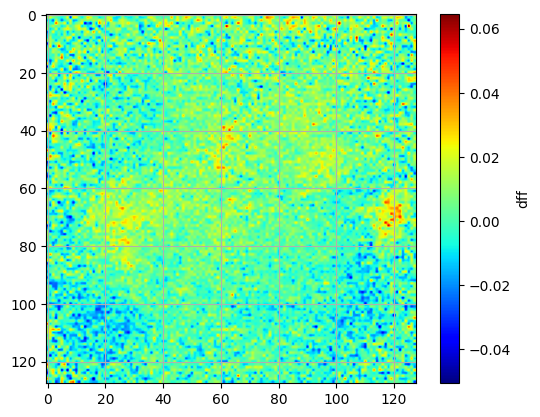

In [23]:
#plot of spatial signal without spatial smoothing
non_smoothed = plot_frame(dff_signal, frame_number, cmap = "jet", color_label = "dff")

#### 6A.2: spatial smoothing applied (gaussian, 3 pixels)

  0%|                                                                                          | 0/128 [00:00<?, ?it/s]

  1%|▋                                                                                 | 1/128 [00:00<00:37,  3.39it/s]

  2%|█▎                                                                                | 2/128 [00:00<00:38,  3.26it/s]

  2%|█▉                                                                                | 3/128 [00:00<00:38,  3.26it/s]

  3%|██▌                                                                               | 4/128 [00:01<00:37,  3.35it/s]

  4%|███▏                                                                              | 5/128 [00:01<00:37,  3.32it/s]

  5%|███▊                                                                              | 6/128 [00:01<00:36,  3.31it/s]

  5%|████▍                                                                             | 7/128 [00:02<00:38,  3.14it/s]

  6%|█████▏                                                                            | 8/128 [00:02<00:40,  3.00it/s]

  7%|█████▊                                                                            | 9/128 [00:02<00:40,  2.97it/s]

  8%|██████▎                                                                          | 10/128 [00:03<00:39,  3.01it/s]

  9%|██████▉                                                                          | 11/128 [00:03<00:37,  3.14it/s]

  9%|███████▌                                                                         | 12/128 [00:03<00:35,  3.26it/s]

 10%|████████▏                                                                        | 13/128 [00:04<00:34,  3.30it/s]

 11%|████████▊                                                                        | 14/128 [00:04<00:35,  3.24it/s]

 12%|█████████▍                                                                       | 15/128 [00:04<00:34,  3.31it/s]

 12%|██████████▏                                                                      | 16/128 [00:05<00:35,  3.20it/s]

 13%|██████████▊                                                                      | 17/128 [00:05<00:33,  3.27it/s]

 14%|███████████▍                                                                     | 18/128 [00:05<00:35,  3.10it/s]

 15%|████████████                                                                     | 19/128 [00:05<00:34,  3.18it/s]

 16%|████████████▋                                                                    | 20/128 [00:06<00:33,  3.19it/s]

 16%|█████████████▎                                                                   | 21/128 [00:06<00:33,  3.17it/s]

 17%|█████████████▉                                                                   | 22/128 [00:06<00:33,  3.16it/s]

 18%|██████████████▌                                                                  | 23/128 [00:07<00:32,  3.22it/s]

 19%|███████████████▏                                                                 | 24/128 [00:07<00:33,  3.09it/s]

 20%|███████████████▊                                                                 | 25/128 [00:07<00:34,  3.00it/s]

 20%|████████████████▍                                                                | 26/128 [00:08<00:33,  3.08it/s]

 21%|█████████████████                                                                | 27/128 [00:08<00:31,  3.16it/s]

 22%|█████████████████▋                                                               | 28/128 [00:08<00:30,  3.23it/s]

 23%|██████████████████▎                                                              | 29/128 [00:09<00:31,  3.17it/s]

 23%|██████████████████▉                                                              | 30/128 [00:09<00:29,  3.30it/s]

 24%|███████████████████▌                                                             | 31/128 [00:09<00:28,  3.45it/s]

 25%|████████████████████▎                                                            | 32/128 [00:09<00:28,  3.39it/s]

 26%|████████████████████▉                                                            | 33/128 [00:10<00:28,  3.32it/s]

 27%|█████████████████████▌                                                           | 34/128 [00:10<00:27,  3.36it/s]

 27%|██████████████████████▏                                                          | 35/128 [00:10<00:27,  3.39it/s]

 28%|██████████████████████▊                                                          | 36/128 [00:11<00:28,  3.18it/s]

 29%|███████████████████████▍                                                         | 37/128 [00:11<00:27,  3.31it/s]

 30%|████████████████████████                                                         | 38/128 [00:11<00:27,  3.26it/s]

 30%|████████████████████████▋                                                        | 39/128 [00:12<00:27,  3.27it/s]

 31%|█████████████████████████▎                                                       | 40/128 [00:12<00:27,  3.18it/s]

 32%|█████████████████████████▉                                                       | 41/128 [00:12<00:26,  3.23it/s]

 33%|██████████████████████████▌                                                      | 42/128 [00:13<00:26,  3.23it/s]

 34%|███████████████████████████▏                                                     | 43/128 [00:13<00:27,  3.05it/s]

 34%|███████████████████████████▊                                                     | 44/128 [00:13<00:26,  3.18it/s]

 35%|████████████████████████████▍                                                    | 45/128 [00:13<00:25,  3.30it/s]

 36%|█████████████████████████████                                                    | 46/128 [00:14<00:24,  3.30it/s]

 37%|█████████████████████████████▋                                                   | 47/128 [00:14<00:24,  3.31it/s]

 38%|██████████████████████████████▍                                                  | 48/128 [00:14<00:25,  3.18it/s]

 38%|███████████████████████████████                                                  | 49/128 [00:15<00:24,  3.25it/s]

 39%|███████████████████████████████▋                                                 | 50/128 [00:15<00:23,  3.32it/s]

 40%|████████████████████████████████▎                                                | 51/128 [00:15<00:23,  3.33it/s]

 41%|████████████████████████████████▉                                                | 52/128 [00:16<00:22,  3.35it/s]

 41%|█████████████████████████████████▌                                               | 53/128 [00:16<00:23,  3.21it/s]

 42%|██████████████████████████████████▏                                              | 54/128 [00:16<00:23,  3.17it/s]

 43%|██████████████████████████████████▊                                              | 55/128 [00:17<00:23,  3.13it/s]

 44%|███████████████████████████████████▍                                             | 56/128 [00:17<00:23,  3.13it/s]

 45%|████████████████████████████████████                                             | 57/128 [00:17<00:21,  3.23it/s]

 45%|████████████████████████████████████▋                                            | 58/128 [00:18<00:21,  3.28it/s]

 46%|█████████████████████████████████████▎                                           | 59/128 [00:18<00:21,  3.14it/s]

 47%|█████████████████████████████████████▉                                           | 60/128 [00:18<00:21,  3.21it/s]

 48%|██████████████████████████████████████▌                                          | 61/128 [00:18<00:19,  3.35it/s]

 48%|███████████████████████████████████████▏                                         | 62/128 [00:19<00:19,  3.32it/s]

 49%|███████████████████████████████████████▊                                         | 63/128 [00:19<00:19,  3.33it/s]

 50%|████████████████████████████████████████▌                                        | 64/128 [00:19<00:20,  3.10it/s]

 51%|█████████████████████████████████████████▏                                       | 65/128 [00:20<00:19,  3.20it/s]

 52%|█████████████████████████████████████████▊                                       | 66/128 [00:20<00:18,  3.31it/s]

 52%|██████████████████████████████████████████▍                                      | 67/128 [00:20<00:18,  3.31it/s]

 53%|███████████████████████████████████████████                                      | 68/128 [00:21<00:18,  3.32it/s]

 54%|███████████████████████████████████████████▋                                     | 69/128 [00:21<00:18,  3.24it/s]

 55%|████████████████████████████████████████████▎                                    | 70/128 [00:21<00:17,  3.26it/s]

 55%|████████████████████████████████████████████▉                                    | 71/128 [00:21<00:17,  3.34it/s]

 56%|█████████████████████████████████████████████▌                                   | 72/128 [00:22<00:17,  3.29it/s]

 57%|██████████████████████████████████████████████▏                                  | 73/128 [00:22<00:16,  3.39it/s]

 58%|██████████████████████████████████████████████▊                                  | 74/128 [00:22<00:15,  3.42it/s]

 59%|███████████████████████████████████████████████▍                                 | 75/128 [00:23<00:15,  3.47it/s]

 59%|████████████████████████████████████████████████                                 | 76/128 [00:23<00:15,  3.41it/s]

 60%|████████████████████████████████████████████████▋                                | 77/128 [00:23<00:14,  3.47it/s]

 61%|█████████████████████████████████████████████████▎                               | 78/128 [00:24<00:15,  3.25it/s]

 62%|█████████████████████████████████████████████████▉                               | 79/128 [00:24<00:15,  3.13it/s]

 62%|██████████████████████████████████████████████████▋                              | 80/128 [00:24<00:15,  3.13it/s]

 63%|███████████████████████████████████████████████████▎                             | 81/128 [00:25<00:14,  3.27it/s]

 64%|███████████████████████████████████████████████████▉                             | 82/128 [00:25<00:13,  3.30it/s]

 65%|████████████████████████████████████████████████████▌                            | 83/128 [00:25<00:13,  3.35it/s]

 66%|█████████████████████████████████████████████████████▏                           | 84/128 [00:25<00:12,  3.46it/s]

 66%|█████████████████████████████████████████████████████▊                           | 85/128 [00:26<00:12,  3.39it/s]

 67%|██████████████████████████████████████████████████████▍                          | 86/128 [00:26<00:12,  3.46it/s]

 68%|███████████████████████████████████████████████████████                          | 87/128 [00:26<00:12,  3.39it/s]

 69%|███████████████████████████████████████████████████████▋                         | 88/128 [00:27<00:12,  3.28it/s]

 70%|████████████████████████████████████████████████████████▎                        | 89/128 [00:27<00:12,  3.21it/s]

 70%|████████████████████████████████████████████████████████▉                        | 90/128 [00:27<00:11,  3.29it/s]

 71%|█████████████████████████████████████████████████████████▌                       | 91/128 [00:27<00:11,  3.32it/s]

 72%|██████████████████████████████████████████████████████████▏                      | 92/128 [00:28<00:10,  3.34it/s]

 73%|██████████████████████████████████████████████████████████▊                      | 93/128 [00:28<00:10,  3.35it/s]

 73%|███████████████████████████████████████████████████████████▍                     | 94/128 [00:28<00:10,  3.39it/s]

 74%|████████████████████████████████████████████████████████████                     | 95/128 [00:29<00:09,  3.43it/s]

 75%|████████████████████████████████████████████████████████████▊                    | 96/128 [00:29<00:09,  3.30it/s]

 76%|█████████████████████████████████████████████████████████████▍                   | 97/128 [00:29<00:09,  3.35it/s]

 77%|██████████████████████████████████████████████████████████████                   | 98/128 [00:30<00:08,  3.43it/s]

 77%|██████████████████████████████████████████████████████████████▋                  | 99/128 [00:30<00:08,  3.53it/s]

 78%|██████████████████████████████████████████████████████████████▌                 | 100/128 [00:30<00:07,  3.55it/s]

 79%|███████████████████████████████████████████████████████████████▏                | 101/128 [00:30<00:08,  3.35it/s]

 80%|███████████████████████████████████████████████████████████████▊                | 102/128 [00:31<00:07,  3.38it/s]

 80%|████████████████████████████████████████████████████████████████▍               | 103/128 [00:31<00:07,  3.39it/s]

 81%|█████████████████████████████████████████████████████████████████               | 104/128 [00:31<00:07,  3.15it/s]

 82%|█████████████████████████████████████████████████████████████████▋              | 105/128 [00:32<00:07,  3.13it/s]

 83%|██████████████████████████████████████████████████████████████████▎             | 106/128 [00:32<00:06,  3.23it/s]

 84%|██████████████████████████████████████████████████████████████████▉             | 107/128 [00:32<00:06,  3.31it/s]

 84%|███████████████████████████████████████████████████████████████████▌            | 108/128 [00:33<00:05,  3.39it/s]

 85%|████████████████████████████████████████████████████████████████████▏           | 109/128 [00:33<00:05,  3.39it/s]

 86%|████████████████████████████████████████████████████████████████████▊           | 110/128 [00:33<00:05,  3.29it/s]

 87%|█████████████████████████████████████████████████████████████████████▍          | 111/128 [00:33<00:05,  3.38it/s]

 88%|██████████████████████████████████████████████████████████████████████          | 112/128 [00:34<00:04,  3.34it/s]

 88%|██████████████████████████████████████████████████████████████████████▋         | 113/128 [00:34<00:04,  3.30it/s]

 89%|███████████████████████████████████████████████████████████████████████▎        | 114/128 [00:34<00:04,  3.38it/s]

 90%|███████████████████████████████████████████████████████████████████████▉        | 115/128 [00:35<00:03,  3.50it/s]

 91%|████████████████████████████████████████████████████████████████████████▌       | 116/128 [00:35<00:03,  3.57it/s]

 91%|█████████████████████████████████████████████████████████████████████████▏      | 117/128 [00:35<00:03,  3.51it/s]

 92%|█████████████████████████████████████████████████████████████████████████▊      | 118/128 [00:35<00:02,  3.50it/s]

 93%|██████████████████████████████████████████████████████████████████████████▍     | 119/128 [00:36<00:02,  3.45it/s]

 94%|███████████████████████████████████████████████████████████████████████████     | 120/128 [00:36<00:02,  3.23it/s]

 95%|███████████████████████████████████████████████████████████████████████████▋    | 121/128 [00:36<00:02,  3.27it/s]

 95%|████████████████████████████████████████████████████████████████████████████▎   | 122/128 [00:37<00:01,  3.39it/s]

 96%|████████████████████████████████████████████████████████████████████████████▉   | 123/128 [00:37<00:01,  3.23it/s]

 97%|█████████████████████████████████████████████████████████████████████████████▌  | 124/128 [00:37<00:01,  3.25it/s]

 98%|██████████████████████████████████████████████████████████████████████████████▏ | 125/128 [00:38<00:00,  3.37it/s]

 98%|██████████████████████████████████████████████████████████████████████████████▊ | 126/128 [00:38<00:00,  3.46it/s]

 99%|███████████████████████████████████████████████████████████████████████████████▍| 127/128 [00:38<00:00,  3.44it/s]

100%|████████████████████████████████████████████████████████████████████████████████| 128/128 [00:38<00:00,  3.30it/s]

100%|████████████████████████████████████████████████████████████████████████████████| 128/128 [00:38<00:00,  3.28it/s]

frame number 200 plotted


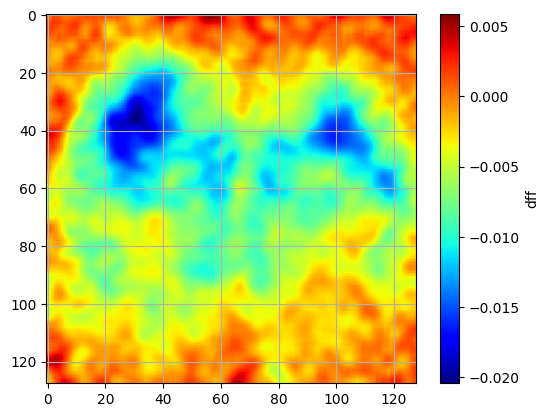

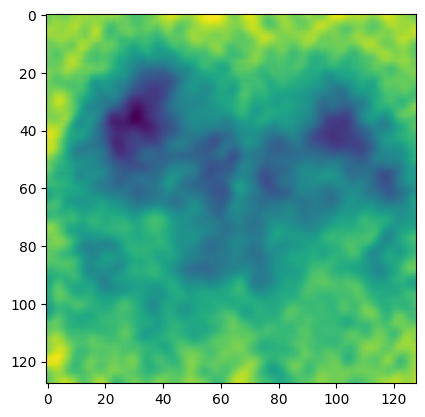

In [24]:
#plot of spatial resolution including spatial smoothing
smoothed_signal = smoothing(dff_signal)
plot_frame(smoothed_signal, 200, cmap = "jet", color_label = "dff")
plt.imshow(smoothed_signal[201])

### 6B: Temporal filtering

dff plot with chebyshev type 1 temporal filtering (high and low bandpass filter)

In [25]:
interactive_plot(smoothed_signal.mean(axis=(1,2)), title_label = "temporally smoothed signal", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 7: ROI plotting

### 7A: ROI full frame

plotting single flash full frame mean

In [26]:
full_roi_single, full_single_segments = avg_trials(single_indices, smoothed_signal, double=False, segment_size=200, minus=20)

In [27]:
interactive_plot(full_roi_single.mean(axis=(1,2)), title_label = "full frame single average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

plotting double flash full frame mean

In [28]:
full_roi_double, full_double_segments = avg_trials(double_indices, smoothed_signal, double=True, segment_size=200, minus=20)

In [29]:
interactive_plot(full_roi_double.mean(axis=(1,2)), title_label = "full frame double average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

plotting NOGO full frame mean

Need to import the text file to know the location of the nogo trials

In [30]:
txt_path = f"X:/RaymondLab/1_Kai/2_Pi_data/{cohort}/{cageID}/stage2_{cageID}_{mouseID}/lick_rates/{session}_data.txt"
txt_file = load_txt(txt_path, fps=30, footer = 4)

successfully loaded txt file


In [31]:
nogo_trials = extract_nogo(txt_file)

# nogo trials: 27


plotting nogo trials

In [32]:
full_roi_nogo, full_nogo_segments = avg_trials(nogo_trials, smoothed_signal, double=False, segment_size=200, minus=20)

In [33]:
interactive_plot(full_roi_nogo.mean(axis=(1,2)), title_label = "full frame NOGO average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

### 7B: V1 ROI

within all of v1 area at the back of the cortex the peak value at 5 frames is taken as the central point and a 15x15 grid is placed around the peak value

plotting single flash just v1 10x10 mean

In [34]:
v1_area_single = extract_v1(full_roi_single, roi_time = 5, roi_start_x=15, roi_start_y = 85, roi_width=45, roi_height = 45)

In [35]:
interactive_plot(v1_area_single.mean(axis=(1,2)), title_label = "v1 single average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

plotting double flash just v1 10x10 mean

In [36]:
v1_area_double = extract_v1(full_roi_double, roi_time = 5, roi_start_x=15, roi_start_y = 85, roi_width=45, roi_height = 45)

In [37]:
interactive_plot(v1_area_double.mean(axis=(1,2)), title_label = "v1 double average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 8: Line up to txt file and success vs fail rate

#### Step 8A: load in txt file from Pi_data folder

In [38]:
txt_path = f"X:/RaymondLab/1_Kai/2_Pi_data/{cohort}/{cageID}/stage2_{cageID}_{mouseID}/lick_rates/{session}_data.txt"
txt_file = load_txt(txt_path, fps=30, footer = 4)

#extract single, double or nogo columns from the txt file
single_txt, double_txt, nogo_txt = extract_success(txt_file)

successfully loaded txt file


#### Step 8B: take the dff signal and sort them into arrays based on success or fail

In [39]:
single_success, single_fail = sort_success(single_txt, full_single_segments)

success = 33
fail = 3
total trials = 36


In [40]:
double_success, double_fail = sort_success(double_txt, full_double_segments)

success = 35
fail = 2
total trials = 37


In [41]:
nogo_success, nogo_fail = sort_success(nogo_txt, full_nogo_segments)

success = 2
fail = 25
total trials = 27


## Step 9: Save the 3D array as a TIFF stack

In [42]:
save_tiff(smoothed_signal, tiff_path_full) # full frame whole session tiff stack
save_tiff(full_roi_single, tiff_path_single) #SINGLE flash averaged response over all trials tiff stack file name to save
save_tiff(full_roi_double, tiff_path_double) #DOUBLE flash averaged response over all trials tiff stack file name to save

  0%|                                                                                        | 0/33538 [00:00<?, ?it/s]

  9%|██████▍                                                                   | 2944/33538 [00:00<00:01, 29325.09it/s]

 18%|████████████▉                                                             | 5877/33538 [00:00<00:01, 25642.98it/s]

 25%|██████████████████▋                                                       | 8471/33538 [00:00<00:00, 25343.52it/s]

 33%|███████████████████████▉                                                 | 11020/33538 [00:00<00:00, 24665.68it/s]

 40%|█████████████████████████████▎                                           | 13495/33538 [00:00<00:00, 21604.43it/s]

 48%|██████████████████████████████████▋                                      | 15956/33538 [00:00<00:00, 22437.65it/s]

 56%|████████████████████████████████████████▉                                | 18822/33538 [00:00<00:00, 24225.48it/s]

 64%|██████████████████████████████████████████████▉                          | 21539/33538 [00:00<00:00, 25031.93it/s]

 72%|████████████████████████████████████████████████████▍                    | 24078/33538 [00:00<00:00, 24342.82it/s]

 79%|█████████████████████████████████████████████████████████▊               | 26539/33538 [00:01<00:00, 24352.22it/s]

 86%|███████████████████████████████████████████████████████████████          | 28993/33538 [00:01<00:00, 23986.98it/s]

 94%|████████████████████████████████████████████████████████████████████▍    | 31445/33538 [00:01<00:00, 24074.75it/s]

100%|█████████████████████████████████████████████████████████████████████████| 33538/33538 [00:01<00:00, 24241.95it/s]

Combined TIFF stack saved successfully.


  0%|                                                                                          | 0/200 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 200/200 [00:00<00:00, 19570.29it/s]

Combined TIFF stack saved successfully.


  0%|                                                                                          | 0/200 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 200/200 [00:00<00:00, 25007.77it/s]

Combined TIFF stack saved successfully.


### Step 9B: Pickle for uploading into other scripts

In [43]:
# Now you can use these file paths in your code
with open(pickle_single_v1, 'wb') as f:
    pickle.dump(v1_area_single, f)

with open(pickle_double_v1, 'wb') as f:
    pickle.dump(v1_area_double, f)

with open(pickle_single_success_ff, 'wb') as f:
    pickle.dump(single_success, f)

with open(pickle_single_fail_ff, 'wb') as f:
    pickle.dump(single_fail, f)

with open(pickle_double_success_ff, 'wb') as f:
    pickle.dump(double_success, f)

with open(pickle_double_fail_ff, 'wb') as f:
    pickle.dump(double_fail, f)

with open(pickle_nogo_success_ff, 'wb') as f:
    pickle.dump(nogo_success, f)

with open(pickle_nogo_fail_ff, 'wb') as f:
    pickle.dump(nogo_fail, f)

# Mask and animate figures

#### currently not using these, good for visualization and flair

In [44]:
#masking = load_masks(dff_signal)
#mask, mask_outline = masking[0], masking[1]

#masked_smoothed_signal = smoothed_signal*mask
#masked_full_roi_single = full_roi_single*mask
#masked_full_roi_double = full_roi_double*mask

In [45]:
#file_path_ = "X:/Raymond Lab/Kaiiiii/processed_data/ #429904_m1_stage2_day2_with_spouts.tiff"
#save_tiff(masked_smoothed_signal, file_path)

#file_path = "X:/Raymond Lab/Kaiiiii/processed_data/ #429904_m1_stage2_day2_with_spouts_avg_single.tiff"
#save_tiff(masked_full_roi_single, file_path)

#file_path = "X:/Raymond Lab/Kaiiiii/processed_data/ #429904_m1_stage2_day2_with_spouts_avg_double.tiff"
#save_tiff(masked_full_roi_double, file_path)

#print(f"TIFF stack saved at: {file_path}")